# Census  Income Project

## Prelude: 
This data was extracted by Ronny Kohavi & Barry Becker from 1994 Census bureau database. These records are a set of clean records extracted. The conditions for data extraction are AAGE> 16, AGI> 100 and AFNLWGT> 1.

Final Weight is controlled by independent estimates of the civilian non-institutional population of the US. The control measures used are : 

1.	A single cell estimate of the population 16+ for each state.
2.	Controls for Hispanic Origin by age and sex.
3.	Controls by Race, age and sex.

We use all three sets of controls in our weighting program and "rake" through them 6 times so that by the end we come back to all the controls we used. The term estimate refers to population totals derived from CPS by creating "weighted tallies" of any specified socio-economic characteristics of the population. People with similar demographic characteristics should have similar weights. There is one important caveat to remember about this statement. That is that since the CPS sample is actually a collection of 51 state samples, each with its own probability of selection, the statement only applies within state.

## About the  Variables:

The following are the independent variables:

1. Age: A numeric categorical variable depicting the age of an individual

2. Work Class: A categorical variable stating the working status of an individual

3. Fnlwgt: Final weight as explained in the above paragraph

4. Education: A categorical variable describing the education level received by an individual

5. Education_num: A numeric categorical variable categorizing education level

6. Marital Status: A categorical variable depicting the marital status of an individual

7. Occupation: A categorical variable depicting the occupation of an individual

8. Relationship: A categorical variable describing the relationship of an individual

9. Race: A categorical variable describing the racial status of an individual

10. Sex: A categorical variable stating the gender of an individual

11. Capital Gain: A continuous variable depicting income gained from trading

12. Capital Loss: A continuous variable depicting income loss from trading

13. Hours per week: A numeric categorical variable depicting the number of hours worked per week

14. Native_Country: A categorical variable stating the native country of an individual

The dependent variable is:

Income: A categorical variable classifying an individual whether he earns more than $ 50,000 a year or not

## Problem statement:

We have to build a classification model to predict wether an individual earns more than $ 50,000 a year

In [1]:
# Importing necessary packages

# Importing fundamental packages
import warnings
warnings.filterwarnings("ignore")
from IPython.core.interactiveshell import InteractiveShell        ## To display multiple outputs
InteractiveShell.ast_node_interactivity = "all"
import pyforest            

## For visualization
import matplotlib.pyplot as plt                                         
%matplotlib inline

import seaborn as sns

from plotly.subplots import make_subplots
import plotly.graph_objects as go
import plotly.express as px

## Data Pre-Processing Packages
from scipy.stats import chi2_contingency
from sklearn import metrics
from sklearn import preprocessing
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import RobustScaler
from scipy.stats import zscore
from imblearn.over_sampling import RandomOverSampler
from imblearn.over_sampling import SMOTE
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OrdinalEncoder
from sklearn.preprocessing import LabelEncoder
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn.impute import KNNImputer
from sklearn.datasets import make_blobs
from sklearn.cluster import DBSCAN
from collections import Counter
from sklearn.cluster import KMeans
from sklearn.cluster import MiniBatchKMeans
from sklearn.preprocessing import PowerTransformer
from sklearn.model_selection import KFold
from sklearn.feature_selection import RFE
from sklearn.preprocessing import scale

## To create copy of data
import copy

## Pipeline Packages

from sklearn.pipeline import Pipeline
from sklearn.pipeline import make_pipeline


## Ensemble Learning Algorithms Packages

from sklearn.ensemble import RandomForestClassifier
from sklearn import tree
import xgboost as xgb
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import loguniform
from sklearn.linear_model import Ridge

## Evaluation Metrics Packages
import statsmodels.api as sm
from scipy.stats import f
from statsmodels.formula.api import ols
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV
from sklearn.utils import resample
from sklearn import metrics
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn import preprocessing
from sklearn.metrics import average_precision_score, confusion_matrix, accuracy_score, classification_report, plot_confusion_matrix
from sklearn.metrics import roc_curve, auc

# Bagging and Boosting
from sklearn.ensemble import BaggingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import cross_val_score
from sklearn.ensemble import AdaBoostClassifier                           

# Saving the model
import pickle

In [2]:
def read(link):
    global data

    data=pd.read_csv(link)
    
    data=pd.DataFrame(data)
    print(data)

In [3]:
read(link="census_income.csv")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

       Age          Workclass  Fnlwgt    Education  Education_num  \
0       50   Self-emp-not-inc   83311    Bachelors             13   
1       38            Private  215646      HS-grad              9   
2       53            Private  234721         11th              7   
3       28            Private  338409    Bachelors             13   
4       37            Private  284582      Masters             14   
...    ...                ...     ...          ...            ...   
32555   27            Private  257302   Assoc-acdm             12   
32556   40            Private  154374      HS-grad              9   
32557   58            Private  151910      HS-grad              9   
32558   22            Private  201490      HS-grad              9   
32559   52       Self-emp-inc  287927      HS-grad              9   

            Marital_status          Occupation    Relationship    Race  \
0       Married-civ-spouse     Exec-managerial         Husband   White   
1                 Divor

## Exploratory Data Analysis (EDA)

In [4]:
# Understanding the fundamentals of the given data set

def eda1(mydata):                                    # Defining function
    
    print("The first 10 rows:", "\n",mydata.head(10))                              # to display first 10 records
    print("\n")                               
    print("The last 10 rows:", "\n",mydata.tail(10))                              # to display last 10 records
    print("\n")
    print("\n")
    
    print("The constitution of the given data:","\n", data.info())                 # to understand attributes of the data
    
    print("\n")
    print("\n")
    print("Skewness for the data","\n",mydata.skew())       # to get skewness of the data, skewness=0 for normal distribution
    print("\n")
    print("Kurosis for the data","\n",mydata.kurtosis() )            # to get kutosis, kurtosis <=3 for normal distribution
    print("\n")
    print("\n")
    

In [5]:
eda1(mydata=data)

The first 10 rows: 
    Age          Workclass  Fnlwgt      Education  Education_num  \
0   50   Self-emp-not-inc   83311      Bachelors             13   
1   38            Private  215646        HS-grad              9   
2   53            Private  234721           11th              7   
3   28            Private  338409      Bachelors             13   
4   37            Private  284582        Masters             14   
5   49            Private  160187            9th              5   
6   52   Self-emp-not-inc  209642        HS-grad              9   
7   31            Private   45781        Masters             14   
8   42            Private  159449      Bachelors             13   
9   37            Private  280464   Some-college             10   

           Marital_status          Occupation    Relationship    Race  \
0      Married-civ-spouse     Exec-managerial         Husband   White   
1                Divorced   Handlers-cleaners   Not-in-family   White   
2      Married-civ-spo

The schema for the dataset is 32560 rows and 15 columns

There are no missing values

The data is skewed

In [6]:
data.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
Age,32560.0,38.581634,13.640642,17.0,28.0,37.0,48.0,90.0
Fnlwgt,32560.0,189781.814373,105549.764924,12285.0,117831.5,178363.0,237054.5,1484705.0
Education_num,32560.0,10.080590,2.572709,1.0,9.0,10.0,12.0,16.0
Capital_gain,32560.0,1077.615172,7385.402999,0.0,0.0,0.0,0.0,99999.0
Capital_loss,32560.0,87.306511,402.966116,0.0,0.0,0.0,0.0,4356.0
Hours_per_week,32560.0,40.437469,12.347618,1.0,40.0,40.0,45.0,99.0


The average age is 38.58 years

The average final weight is 189781.81

The average hours per week of work is 40.44 hours

In [7]:
### Encoding data variables

In [8]:
data["Workclass"].value_counts()
data["Education"].value_counts()
data["Marital_status"].value_counts()
data["Occupation"].value_counts()
data["Relationship"].value_counts()
data["Race"].value_counts()
data["Sex"].value_counts()
data["Native_country"].value_counts()
data["Income"].value_counts()

 Private             22696
 Self-emp-not-inc     2541
 Local-gov            2093
 ?                    1836
 State-gov            1297
 Self-emp-inc         1116
 Federal-gov           960
 Without-pay            14
 Never-worked            7
Name: Workclass, dtype: int64

 HS-grad         10501
 Some-college     7291
 Bachelors        5354
 Masters          1723
 Assoc-voc        1382
 11th             1175
 Assoc-acdm       1067
 10th              933
 7th-8th           646
 Prof-school       576
 9th               514
 12th              433
 Doctorate         413
 5th-6th           333
 1st-4th           168
 Preschool          51
Name: Education, dtype: int64

 Married-civ-spouse       14976
 Never-married            10682
 Divorced                  4443
 Separated                 1025
 Widowed                    993
 Married-spouse-absent      418
 Married-AF-spouse           23
Name: Marital_status, dtype: int64

 Prof-specialty       4140
 Craft-repair         4099
 Exec-managerial      4066
 Adm-clerical         3769
 Sales                3650
 Other-service        3295
 Machine-op-inspct    2002
 ?                    1843
 Transport-moving     1597
 Handlers-cleaners    1370
 Farming-fishing       994
 Tech-support          928
 Protective-serv       649
 Priv-house-serv       149
 Armed-Forces            9
Name: Occupation, dtype: int64

 Husband           13193
 Not-in-family      8304
 Own-child          5068
 Unmarried          3446
 Wife               1568
 Other-relative      981
Name: Relationship, dtype: int64

 White                 27815
 Black                  3124
 Asian-Pac-Islander     1039
 Amer-Indian-Eskimo      311
 Other                   271
Name: Race, dtype: int64

 Male      21789
 Female    10771
Name: Sex, dtype: int64

 United-States                 29169
 Mexico                          643
 ?                               583
 Philippines                     198
 Germany                         137
 Canada                          121
 Puerto-Rico                     114
 El-Salvador                     106
 India                           100
 Cuba                             95
 England                          90
 Jamaica                          81
 South                            80
 China                            75
 Italy                            73
 Dominican-Republic               70
 Vietnam                          67
 Guatemala                        64
 Japan                            62
 Poland                           60
 Columbia                         59
 Taiwan                           51
 Haiti                            44
 Iran                             43
 Portugal                         37
 Nicaragua                        34
 Peru                             31
 

 <=50K    24719
 >50K      7841
Name: Income, dtype: int64

We have missing values in categories, however let us encode and check the significance of the variables first

In [9]:
# Encoding Attrition
enc = OrdinalEncoder()
data[["Workclass"]] = enc.fit_transform(data[["Workclass"]])
data[["Education"]] = enc.fit_transform(data[["Education"]])
data[["Marital_status"]] = enc.fit_transform(data[["Marital_status"]])
data[["Occupation"]] = enc.fit_transform(data[["Occupation"]])
data[["Relationship"]] = enc.fit_transform(data[["Relationship"]])
data[["Race"]] = enc.fit_transform(data[["Race"]])
data[["Sex"]] = enc.fit_transform(data[["Sex"]])
data[["Native_country"]] = enc.fit_transform(data[["Native_country"]])
data[["Income"]] = enc.fit_transform(data[["Income"]])

In [10]:
data["Workclass"].value_counts()
data["Education"].value_counts()
data["Marital_status"].value_counts()
data["Occupation"].value_counts()
data["Relationship"].value_counts()
data["Race"].value_counts()
data["Sex"].value_counts()
data["Native_country"].value_counts()
data["Income"].value_counts()

4.0    22696
6.0     2541
2.0     2093
0.0     1836
7.0     1297
5.0     1116
1.0      960
8.0       14
3.0        7
Name: Workclass, dtype: int64

11.0    10501
15.0     7291
9.0      5354
12.0     1723
8.0      1382
1.0      1175
7.0      1067
0.0       933
5.0       646
14.0      576
6.0       514
2.0       433
10.0      413
4.0       333
3.0       168
13.0       51
Name: Education, dtype: int64

2.0    14976
4.0    10682
0.0     4443
5.0     1025
6.0      993
3.0      418
1.0       23
Name: Marital_status, dtype: int64

10.0    4140
3.0     4099
4.0     4066
1.0     3769
12.0    3650
8.0     3295
7.0     2002
0.0     1843
14.0    1597
6.0     1370
5.0      994
13.0     928
11.0     649
9.0      149
2.0        9
Name: Occupation, dtype: int64

0.0    13193
1.0     8304
3.0     5068
4.0     3446
5.0     1568
2.0      981
Name: Relationship, dtype: int64

4.0    27815
2.0     3124
1.0     1039
0.0      311
3.0      271
Name: Race, dtype: int64

1.0    21789
0.0    10771
Name: Sex, dtype: int64

39.0    29169
26.0      643
0.0       583
30.0      198
11.0      137
2.0       121
33.0      114
8.0       106
19.0      100
5.0        95
9.0        90
23.0       81
35.0       80
3.0        75
22.0       73
6.0        70
40.0       67
13.0       64
24.0       62
31.0       60
4.0        59
36.0       51
14.0       44
20.0       43
32.0       37
27.0       34
29.0       31
10.0       29
12.0       29
7.0        28
21.0       24
17.0       20
1.0        19
38.0       19
25.0       18
37.0       18
41.0       16
28.0       14
16.0       13
18.0       13
34.0       12
15.0        1
Name: Native_country, dtype: int64

0.0    24719
1.0     7841
Name: Income, dtype: int64

### Data Visualization

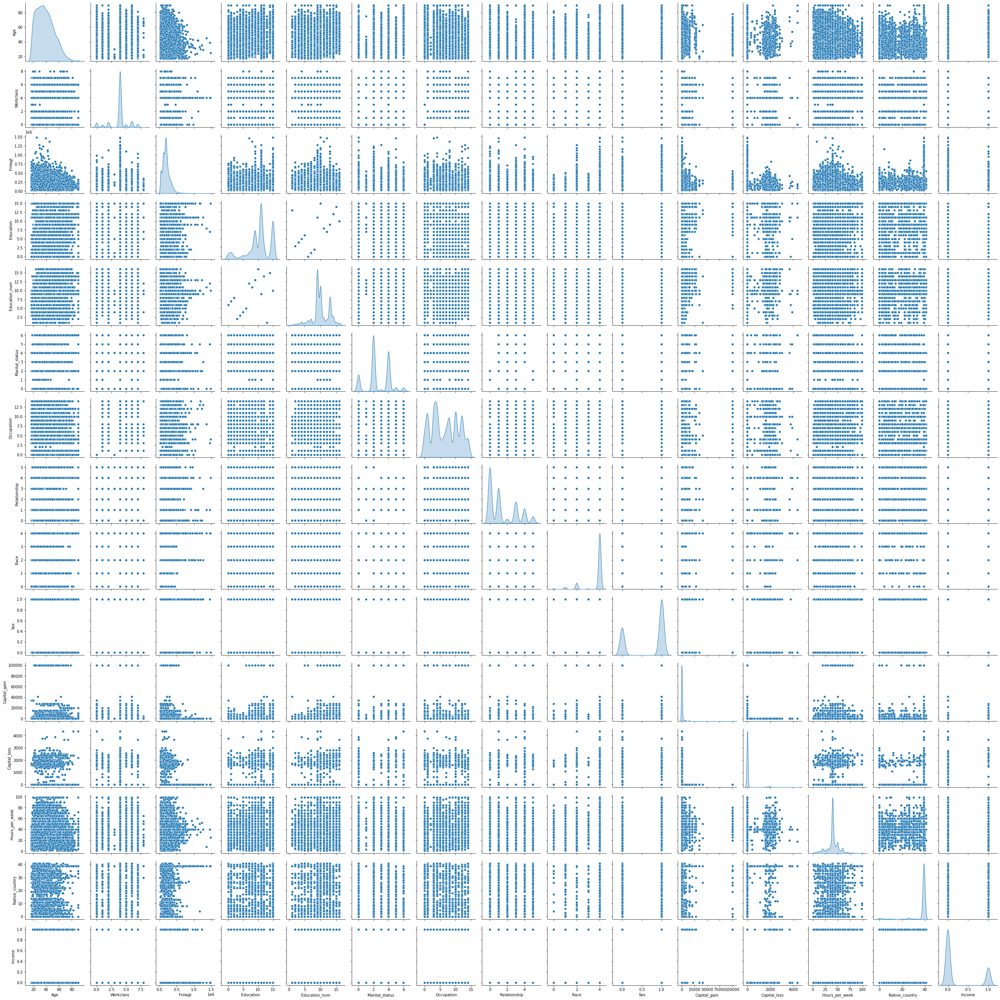

In [11]:
sns.pairplot(data, kind='scatter', diag_kind='kde')                       # to represent data graphically

<Figure size 2160x2160 with 0 Axes>

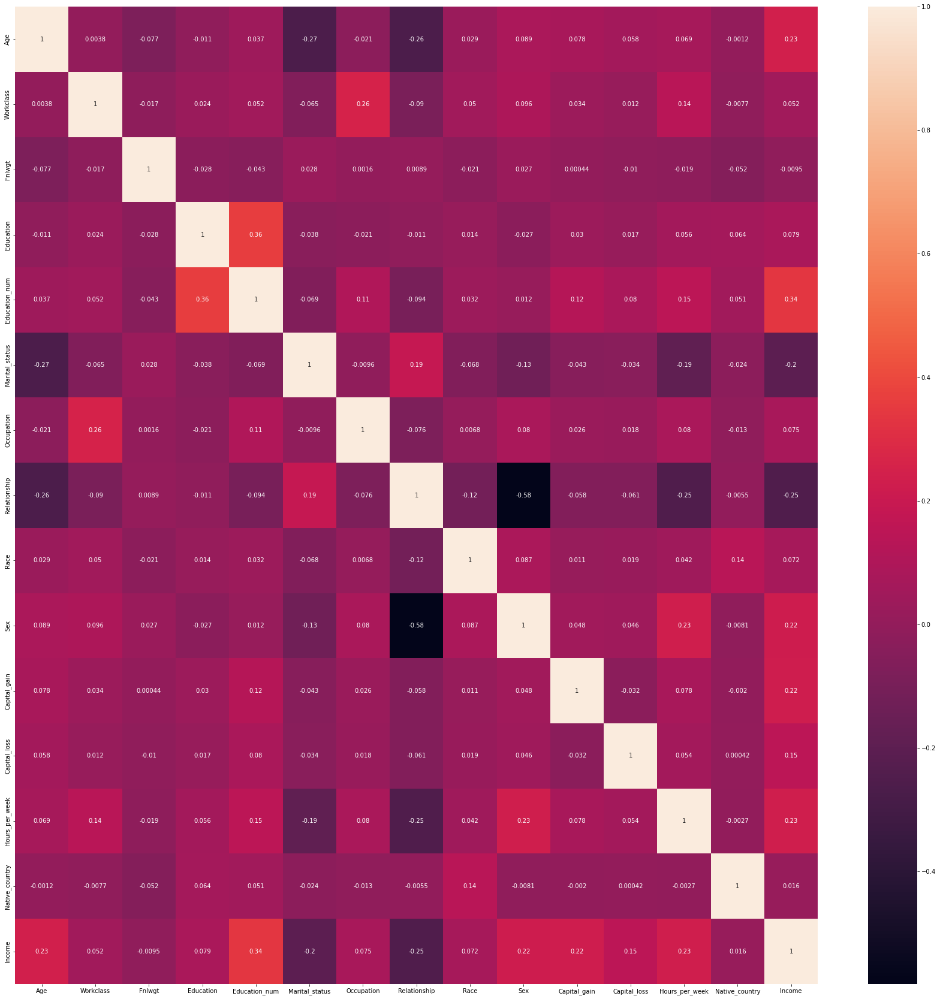

In [12]:
plt.figure(figsize=(30,30))                      
plot=sns.heatmap(data.corr(method = "pearson"), annot = True)
fig2=plot.get_figure()

In [13]:
def outlier(mydata):                        # Outlier Plotting
    for i in mydata.columns:
        fig = px.box(mydata, y= i, width=600, height=400, title=i, template="plotly_dark")
        fig.show()

In [14]:
outlier(mydata=data)

<AxesSubplot:xlabel='Income', ylabel='Density'>

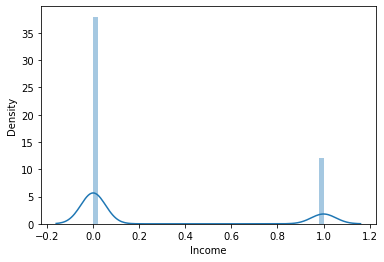

In [15]:
# Distplot for Income
sns.distplot(data["Income"])

<AxesSubplot:xlabel='Age', ylabel='Density'>

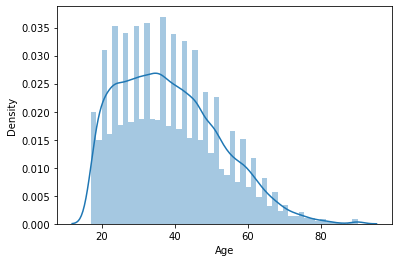

In [16]:
# Distplot for Age
sns.distplot(data['Age'])

<AxesSubplot:xlabel='Age', ylabel='Income'>

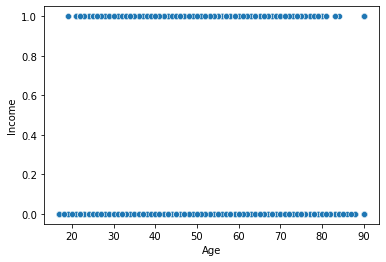

In [17]:
# Scatterplot for Age and Income

sns.scatterplot(x="Age",y="Income",data=data)

<AxesSubplot:xlabel='Workclass', ylabel='Density'>

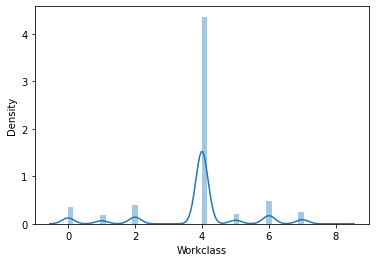

In [18]:
# Distplot for WorkclassWorkclass
sns.distplot(data['Workclass'])

<AxesSubplot:xlabel='Workclass', ylabel='Income'>

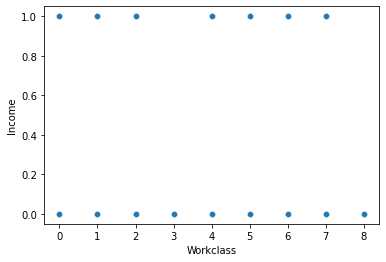

In [19]:
# Scatterplot for Workclass and Income

sns.scatterplot(x="Workclass",y="Income",data=data)

<AxesSubplot:xlabel='Fnlwgt', ylabel='Density'>

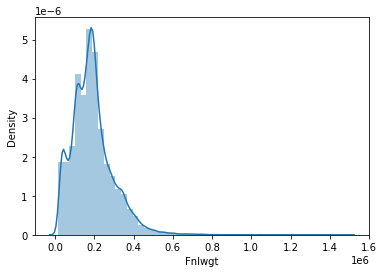

In [20]:
# Distplot for Fnlwgt
sns.distplot(data['Fnlwgt'])

<AxesSubplot:xlabel='Fnlwgt', ylabel='Income'>

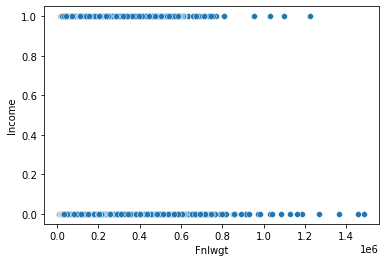

In [21]:
# Scatterplot for Fnlwgt and Income

sns.scatterplot(x="Fnlwgt",y="Income",data=data)

<AxesSubplot:xlabel='Education', ylabel='Density'>

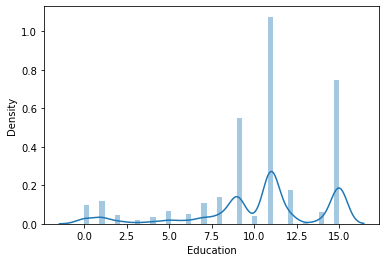

In [22]:
# Distplot for Education
sns.distplot(data['Education'])

<AxesSubplot:xlabel='Education', ylabel='Income'>

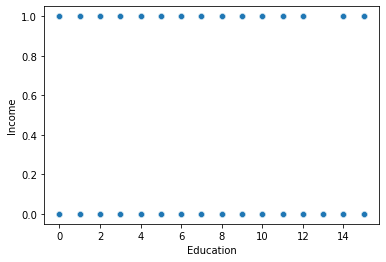

In [23]:
# Scatterplot for Education and Income

sns.scatterplot(x="Education",y="Income",data=data)

<AxesSubplot:xlabel='Education_num', ylabel='Density'>

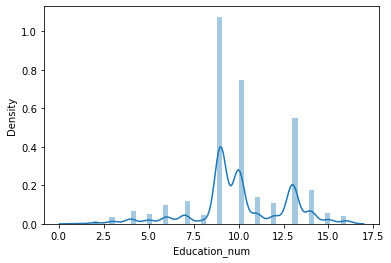

In [24]:
# Distplot for Education_num
sns.distplot(data['Education_num'])

<AxesSubplot:xlabel='Education_num', ylabel='Income'>

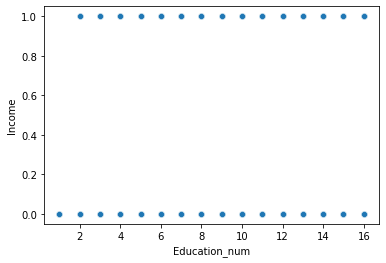

In [25]:
# Scatterplot for Education_num and Income

sns.scatterplot(x="Education_num",y="Income",data=data)

<AxesSubplot:xlabel='Marital_status', ylabel='Density'>

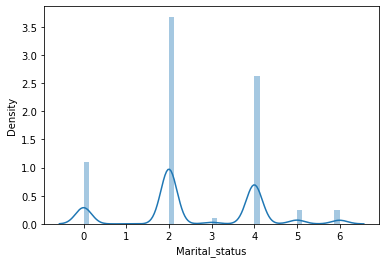

In [26]:
# Distplot for Marital_status
sns.distplot(data['Marital_status'])

<AxesSubplot:xlabel='Marital_status', ylabel='Income'>

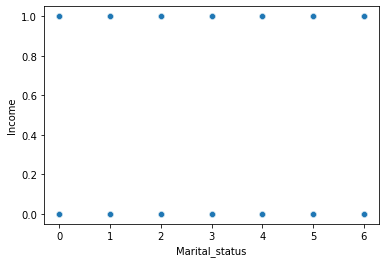

In [27]:
# Scatterplot for Marital_status and Income

sns.scatterplot(x="Marital_status",y="Income",data=data)

<AxesSubplot:xlabel='Occupation', ylabel='Density'>

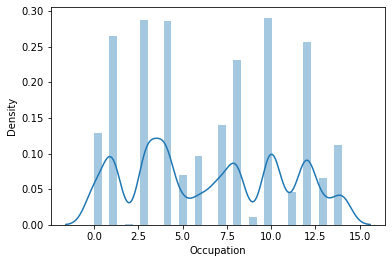

In [28]:
# Distplot for Occupation
sns.distplot(data['Occupation'])

<AxesSubplot:xlabel='Occupation', ylabel='Income'>

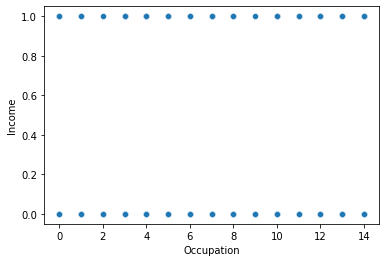

In [29]:
# Scatterplot for Occupation and Income

sns.scatterplot(x="Occupation",y="Income",data=data)

<AxesSubplot:xlabel='Relationship', ylabel='Density'>

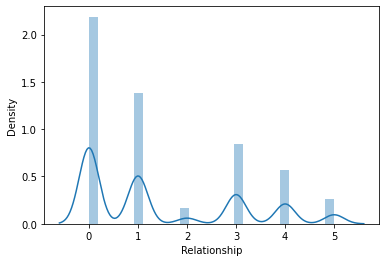

In [30]:
# Distplot for Relationship
sns.distplot(data['Relationship'])

<AxesSubplot:xlabel='Relationship', ylabel='Income'>

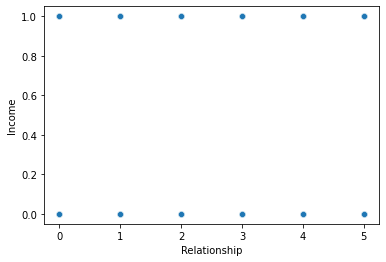

In [31]:
# Scatterplot for Relationship and Income

sns.scatterplot(x="Relationship",y="Income",data=data)

<AxesSubplot:xlabel='Race', ylabel='Density'>

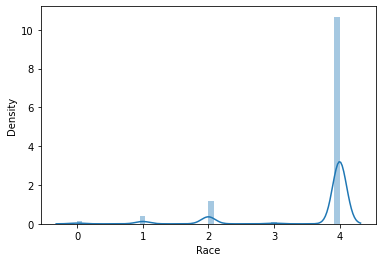

In [32]:
# Distplot for Race
sns.distplot(data['Race'])

<AxesSubplot:xlabel='Race', ylabel='Income'>

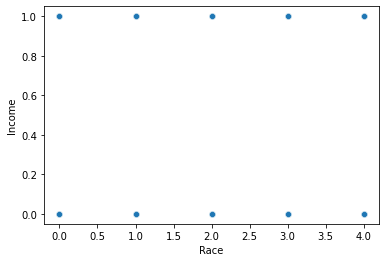

In [33]:
# Scatterplot for Race and Income

sns.scatterplot(x="Race",y="Income",data=data)

<AxesSubplot:xlabel='Sex', ylabel='Density'>

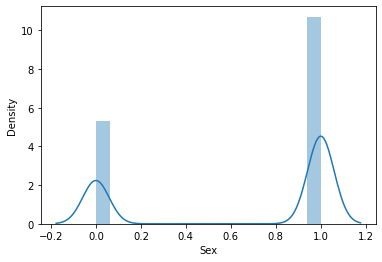

In [34]:
# Distplot for Sex
sns.distplot(data['Sex'])

<AxesSubplot:xlabel='Sex', ylabel='Income'>

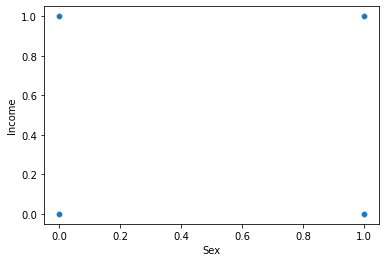

In [35]:
# Scatterplot for Sex and Income

sns.scatterplot(x="Sex",y="Income",data=data)

<AxesSubplot:xlabel='Capital_gain', ylabel='Density'>

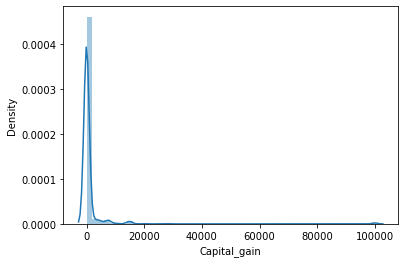

In [36]:
# Distplot for Capital_gain
sns.distplot(data['Capital_gain'])

<AxesSubplot:xlabel='Capital_gain', ylabel='Income'>

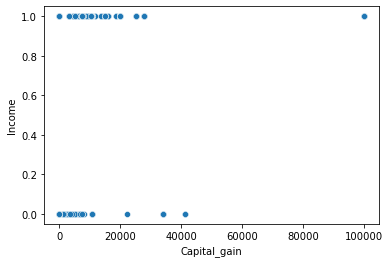

In [37]:
# Scatterplot for Capital_gain and Income

sns.scatterplot(x="Capital_gain",y="Income",data=data)

<AxesSubplot:xlabel='Capital_loss', ylabel='Density'>

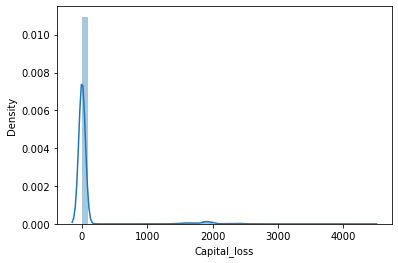

In [38]:
# Distplot for Capital_loss
sns.distplot(data['Capital_loss'])

<AxesSubplot:xlabel='Capital_loss', ylabel='Income'>

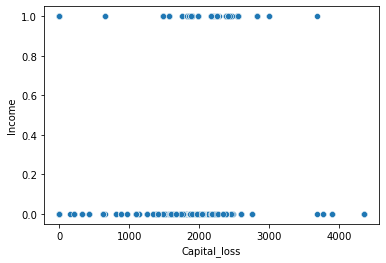

In [39]:
# Scatterplot for Capital_loss and Income

sns.scatterplot(x="Capital_loss",y="Income",data=data)

<AxesSubplot:xlabel='Hours_per_week', ylabel='Density'>

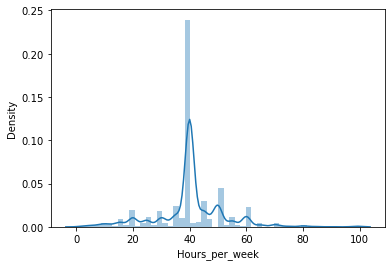

In [40]:
# Distplot for Hours_per_week
sns.distplot(data['Hours_per_week'])

<AxesSubplot:xlabel='Hours_per_week', ylabel='Income'>

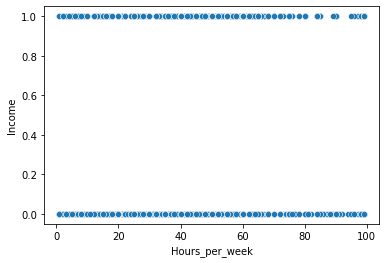

In [41]:
# Scatterplot for Hours_per_week and Income

sns.scatterplot(x="Hours_per_week",y="Income",data=data)

<AxesSubplot:xlabel='Relationship', ylabel='Density'>

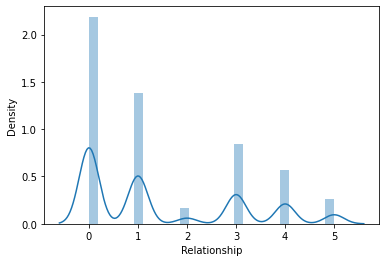

In [42]:
# Distplot for Relationship
sns.distplot(data['Relationship'])

<AxesSubplot:xlabel='Native_country', ylabel='Income'>

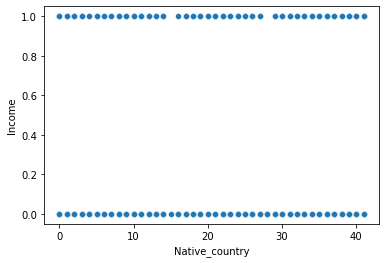

In [43]:
# Scatterplot for Native_country and Income

sns.scatterplot(x="Native_country",y="Income",data=data)

### Hypothesis Testing

In [44]:
# Creating a cross tab for hypothesis testing between Workclass and Income


crosstab = pd.crosstab(data["Workclass"], data["Income"])

# h0:  Workclass  does not affect the Income
# ha:  Workclass  does affect the Income

# defining the table
stat, p, dof, expected = chi2_contingency(crosstab)

# interpret p-value
alpha = 0.05
print("p value is " , str(p))
if p <= alpha:
    print('Dependent (reject H0)')
else:
    print('Independent (H0 holds true)')



<IPython.core.display.Javascript object>

p value is  1.9613536197342886e-220
Dependent (reject H0)


In [45]:
# Creating a cross tab for hypothesis testing between Education and Income

crosstab = pd.crosstab(data["Education"], data["Income"])

# h0:  Education  does not affect the Income
# ha:  Education  does affect the Income

# defining the table
stat, p, dof, expected = chi2_contingency(crosstab)

# interpret p-value
alpha = 0.05
print("p value is " , str(p))
if p <= alpha:
    print('Dependent (reject H0)')
else:
    print('Independent (H0 holds true)')

<IPython.core.display.Javascript object>

p value is  0.0
Dependent (reject H0)


In [46]:
# Creating a cross tab for hypothesis testing between Marital_status and Income


crosstab = pd.crosstab(data["Marital_status"], data["Income"])

# h0:  Marital_status  does not affect the Loan_Status
# ha:  Marital_status  does affect the Loan_Status

# defining the table
stat, p, dof, expected = chi2_contingency(crosstab)

# interpret p-value
alpha = 0.05
print("p value is " , str(p))
if p <= alpha:
    print('Dependent (reject H0)')
else:
    print('Independent (H0 holds true)')



<IPython.core.display.Javascript object>

p value is  0.0
Dependent (reject H0)


In [47]:
# Creating a cross tab for hypothesis testing between Occupation and Income


crosstab = pd.crosstab(data["Occupation"], data["Income"])

# h0:  Occupation  does not affect the Income
# ha:  Occupation  does affect the Income

# defining the table
stat, p, dof, expected = chi2_contingency(crosstab)

# interpret p-value
alpha = 0.05
print("p value is " , str(p))
if p <= alpha:
    print('Dependent (reject H0)')
else:
    print('Independent (H0 holds true)')



<IPython.core.display.Javascript object>

p value is  0.0
Dependent (reject H0)


In [48]:
# Creating a cross tab for hypothesis testing between Relationship and Income


crosstab = pd.crosstab(data["Relationship"], data["Income"])

# h0:  Relationship  does not affect the Income
# ha:  Relationship  does affect the Income

# defining the table
stat, p, dof, expected = chi2_contingency(crosstab)

# interpret p-value
alpha = 0.05
print("p value is " , str(p))
if p <= alpha:
    print('Dependent (reject H0)')
else:
    print('Independent (H0 holds true)')



<IPython.core.display.Javascript object>

p value is  0.0
Dependent (reject H0)


In [49]:
# Creating a cross tab for hypothesis testing between Race and Income


crosstab = pd.crosstab(data["Race"], data["Income"])

# h0:  Race  does not affect the Income
# ha:  Race  does affect the Income

# defining the table
stat, p, dof, expected = chi2_contingency(crosstab)

# interpret p-value
alpha = 0.05
print("p value is " , str(p))
if p <= alpha:
    print('Dependent (reject H0)')
else:
    print('Independent (H0 holds true)')



<IPython.core.display.Javascript object>

p value is  2.2673780743416745e-70
Dependent (reject H0)


In [50]:
# Creating a cross tab for hypothesis testing between Sex and Income


crosstab = pd.crosstab(data["Sex"], data["Income"])

# h0:  Sex  does not affect the Income
# ha:  Sex  does affect the Income

# defining the table
stat, p, dof, expected = chi2_contingency(crosstab)

# interpret p-value
alpha = 0.05
print("p value is " , str(p))
if p <= alpha:
    print('Dependent (reject H0)')
else:
    print('Independent (H0 holds true)')



<IPython.core.display.Javascript object>

p value is  0.0
Dependent (reject H0)


In [51]:
# Creating a cross tab for hypothesis testing between Native_country and Income


crosstab = pd.crosstab(data["Native_country"], data["Income"])

# h0:  Native_country  does not affect the Income
# ha:  Native_country  does affect the Income

# defining the table
stat, p, dof, expected = chi2_contingency(crosstab)

# interpret p-value
alpha = 0.05
print("p value is " , str(p))
if p <= alpha:
    print('Dependent (reject H0)')
else:
    print('Independent (H0 holds true)')



<IPython.core.display.Javascript object>

p value is  2.2048669736647796e-44
Dependent (reject H0)


In [52]:
# Anova for Capital Loss and Income
# h0: Capital Loss is not significant to Income
# ha: Capital Loss is significant to Income

mod=ols('Income~Capital_loss',data=data).fit()

# Performing Anova
avotable= sm.stats.anova_lm(mod)
print("\n")
# Print result
print(avotable)



                   df       sum_sq     mean_sq           F         PR(>F)
Capital_loss      1.0   134.873314  134.873314  754.777449  2.757494e-164
Residual      32558.0  5817.880955    0.178693         NaN            NaN


In [53]:
# Anova for Capital Gain and Income
# h0: Capital Gain is not significant to Income
# ha: Capital Gain is significant to Income

mod=ols('Income~Capital_gain',data=data).fit()

# Performing Anova
avotable= sm.stats.anova_lm(mod)
print("\n")
# Print result
print(avotable)



                   df       sum_sq     mean_sq            F  PR(>F)
Capital_gain      1.0   296.908070  296.908070  1709.157677     0.0
Residual      32558.0  5655.846199    0.173716          NaN     NaN


In [54]:
def calc_vif(data):

    # Calculating VIF
    vif = pd.DataFrame()
    vif["variables"] = data.columns
    vif["VIF"] = [variance_inflation_factor(data.values, i) for i in range(data.shape[1])]

    return(vif)

In [55]:
calc_vif(data=data.drop(["Income"],axis=1))

<IPython.core.display.Javascript object>

,variables,VIF
0,Age,8.521048
1,Workclass,8.476048
2,Fnlwgt,4.031761
3,Education,9.210456
4,Education_num,18.379852
5,Marital_status,3.976061
6,Occupation,3.711144
7,Relationship,2.612271
8,Race,17.577780
9,Sex,4.441515


### Findings:

In [56]:
data_1=data.drop(['Capital_gain','Capital_loss'],axis=1)

### Outlier Treatment

In [57]:
for i in data_1.drop(['Income'],axis=1).columns:
    data_1[i] = np.where(data_1[i] > (data_1[i].quantile(0.75) + (data_1[i].quantile(0.75) - data_1[i].quantile(0.25))*1.5),
                           (data_1[i].quantile(0.75) + (data_1[i].quantile(0.75) - data_1[i].quantile(0.25))*1.5),
                          np.where(data_1[i] < (data_1[i].quantile(0.25) - (data_1[i].quantile(0.75) - data_1[i].quantile(0.25))*1.5),
                           (data_1[i].quantile(0.25) - (data_1[i].quantile(0.75) - data_1[i].quantile(0.25))*1.5),data_1[i]))
    

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [58]:
data_features= data_1.drop(["Income"],axis=1)
data_label=data_1["Income"]

In [59]:
outlier(mydata=data_features)

In [60]:
# Making a copy of the dataset
data_pre=copy.deepcopy(data_1)

In [61]:
data_ft=data_pre.drop(["Income"],axis=1)
data_rest=data_pre[["Income"]]

In [62]:
# Removing skewness using Yeo-Johnson
# Removing data skewness
pt = PowerTransformer(method='yeo-johnson',standardize='True')
    
data_noskew= pt.fit_transform(data_ft.values)
data_noskewtab= pd.DataFrame(data_noskew)
data_noskewtab.columns = data_ft.columns
print(data_noskewtab)

<IPython.core.display.Javascript object>

            Age     Workclass    Fnlwgt  Education  Education_num  \
0      0.894611 -5.551115e-17 -1.122124  -0.539937       1.171920   
1      0.100530 -5.551115e-17  0.404206   0.085048      -0.461820   
2      1.068672 -5.551115e-17  0.583674  -1.806093      -1.267993   
3     -0.734220 -5.551115e-17  1.463450  -0.539937       1.171920   
4      0.025600 -5.551115e-17  1.024488   0.409498       1.584024   
...         ...           ...       ...        ...            ...   
32555 -0.830258 -5.551115e-17  0.787979  -1.129278       0.761175   
32556  0.245754 -5.551115e-17 -0.226382   0.085048      -0.461820   
32557  1.341797 -5.551115e-17 -0.253872   0.085048      -0.461820   
32558 -1.357841 -5.551115e-17  0.266434   0.085048      -0.461820   
32559  1.011559 -5.551115e-17  1.052784   0.085048      -0.461820   

       Marital_status  Occupation  Relationship          Race       Sex  \
0           -0.383427   -0.502825     -1.094635 -5.551115e-17  0.703087   
1           -1.782434

In [63]:
data_final=pd.concat([data_noskewtab,data_rest],axis=1)
print(data_final)

<IPython.core.display.Javascript object>

            Age     Workclass    Fnlwgt  Education  Education_num  \
0      0.894611 -5.551115e-17 -1.122124  -0.539937       1.171920   
1      0.100530 -5.551115e-17  0.404206   0.085048      -0.461820   
2      1.068672 -5.551115e-17  0.583674  -1.806093      -1.267993   
3     -0.734220 -5.551115e-17  1.463450  -0.539937       1.171920   
4      0.025600 -5.551115e-17  1.024488   0.409498       1.584024   
...         ...           ...       ...        ...            ...   
32555 -0.830258 -5.551115e-17  0.787979  -1.129278       0.761175   
32556  0.245754 -5.551115e-17 -0.226382   0.085048      -0.461820   
32557  1.341797 -5.551115e-17 -0.253872   0.085048      -0.461820   
32558 -1.357841 -5.551115e-17  0.266434   0.085048      -0.461820   
32559  1.011559 -5.551115e-17  1.052784   0.085048      -0.461820   

       Marital_status  Occupation  Relationship          Race       Sex  \
0           -0.383427   -0.502825     -1.094635 -5.551115e-17  0.703087   
1           -1.782434

<AxesSubplot:ylabel='Density'>

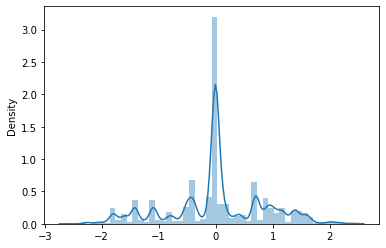

In [64]:
# Dist Plot
sns.distplot(data_final,kde=True, hist=True)

### Splitting the data

In [65]:
def split (data,target):
    data_reset_index = data.reset_index(drop=True)
# Data split
    global x
    global y
    global x_train
    global y_train
    global x_test
    global y_test
# Segregate Feature & Target Variables
    x = data_reset_index.drop(target, axis=1)
    y = data_reset_index[target]
    x_train,x_test,y_train,y_test = train_test_split(x,y, test_size=0.3, random_state=3)
    
    print(x_train.info())
    ("\n")
    print(x_test.info())
    ("\n")
    print(y_train.shape)
    ("\n")
    print(y_test.shape)
    ("\n")

In [66]:
split(data=data_final,
      target="Income")

<class 'pandas.core.frame.DataFrame'>
Int64Index: 22792 entries, 26736 to 5994
Data columns (total 12 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Age             22792 non-null  float64
 1   Workclass       22792 non-null  float64
 2   Fnlwgt          22792 non-null  float64
 3   Education       22792 non-null  float64
 4   Education_num   22792 non-null  float64
 5   Marital_status  22792 non-null  float64
 6   Occupation      22792 non-null  float64
 7   Relationship    22792 non-null  float64
 8   Race            22792 non-null  float64
 9   Sex             22792 non-null  float64
 10  Hours_per_week  22792 non-null  float64
 11  Native_country  22792 non-null  float64
dtypes: float64(12)
memory usage: 2.3 MB
None
<class 'pandas.core.frame.DataFrame'>
Int64Index: 9768 entries, 15728 to 9354
Data columns (total 12 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Age   

In [67]:
data_final["Income"].value_counts()

0.0    24719
1.0     7841
Name: Income, dtype: int64

### Class Imbalance

In [68]:
# Smote
sm = SMOTE(random_state = 5)

columns = x_train.columns

train_data = pd.concat([x_train,y_train], axis = 1)

train_data.head()


<IPython.core.display.Javascript object>

,Age,Workclass,Fnlwgt,Education,Education_num,Marital_status,Occupation,Relationship,Race,Sex,Hours_per_week,Native_country,Income
26736,0.711886,-5.551115e-17,-0.926525,1.425628,-0.055821,-1.782434,-0.502825,1.351388,-5.551115e-17,-1.422298,-0.086801,-1.110223e-16,0.0
12350,-1.357841,-5.551115e-17,-1.967151,1.425628,-0.055821,0.919719,-1.830353,1.091081,-5.551115e-17,-1.422298,-1.587930,-1.110223e-16,0.0
10214,-0.640877,-5.551115e-17,0.289526,-0.539937,1.171920,0.919719,0.829763,0.134511,-5.551115e-17,0.703087,-0.086801,-1.110223e-16,0.0
20829,-0.291423,-5.551115e-17,0.134682,0.409498,1.584024,0.919719,0.829763,0.134511,-5.551115e-17,0.703087,1.351784,-1.110223e-16,0.0
6345,-1.474569,-5.551115e-17,0.481853,-0.839394,0.351889,0.919719,-0.502825,1.091081,-5.551115e-17,0.703087,-0.086801,-1.110223e-16,0.0


In [69]:
# Fitting the model
x_os_train, y_os_train  = sm.fit_resample(train_data.drop('Income', axis = 1), train_data['Income'])

y_os_train.value_counts()

0.0    17328
1.0    17328
Name: Income, dtype: int64

In [70]:
## Number of records in Oversampled Train dataset

print('the number of records in x_os_train :', len(x_os_train))
print('the number of records in y_os_train :', len(y_os_train))
print('the number of records in x_test :', len(x_test))
print('the number of records in y_test :', len(y_test))

# Target Class Distribution for Train and test Dataset

print('the ratio of 0 and 1 in y_os_train:')

print(y_os_train.value_counts(normalize = True)*100)

print('the ratio of 0 and 1 in y_test:')

print(y_test.value_counts(normalize = True)*100)

print("Before UpSampling, counts of label '1': {}".format(sum(y_train==1)))
print("Before UpSampling, counts of label '0': {} \n".format(sum(y_train==0)))

print("After UpSampling, counts of label '1': {}".format(sum(y_os_train==1)))
print("After UpSampling, counts of label '0': {} \n".format(sum(y_os_train==0)))

the number of records in x_os_train : 34656
the number of records in y_os_train : 34656
the number of records in x_test : 9768
the number of records in y_test : 9768
the ratio of 0 and 1 in y_os_train:
0.0    50.0
1.0    50.0
Name: Income, dtype: float64
the ratio of 0 and 1 in y_test:
0.0    75.665438
1.0    24.334562
Name: Income, dtype: float64
Before UpSampling, counts of label '1': 5464
Before UpSampling, counts of label '0': 17328 

After UpSampling, counts of label '1': 17328
After UpSampling, counts of label '0': 17328 



### Scaling the data

In [71]:
scale_1= StandardScaler()
scale_2= MinMaxScaler()
scale_3= RobustScaler()
model= LinearRegression()

<IPython.core.display.Javascript object>

In [72]:
pipe1 = Pipeline([
    ('Scale',scale_1),
    ('model',model),
])    
pipe2 = Pipeline([
    ('Scale',scale_2),
    ('model',model),
])
pipe3 = Pipeline([
    ('Scale',scale_3),
    ('model',model),  
    
])

In [73]:
# Create Function Name 
def pre_process(data, pipe):

# Pipe.fit, pipe.predict and accuracy
    
    pipe.fit(x_train,y_train)
    
    y_pred = pipe.predict(x_test)
    
    score = np.sqrt(metrics.mean_squared_error(y_pred, y_test))
    
    return score

In [74]:
pre_process(data= data_final ,
           pipe= pipe1)

<IPython.core.display.Javascript object>

0.370713623454195

In [75]:
pre_process(data= data_final ,
           pipe= pipe2)

<IPython.core.display.Javascript object>

0.370713623454195

In [76]:
pre_process(data= data_final ,
           pipe= pipe3)

<IPython.core.display.Javascript object>

0.370713623454195

Since all has the same score, let us proceed with MinMax Scaler

In [77]:
scalar= MinMaxScaler()
scalar.fit(x_train)
x_trainsc =  scalar.transform(x_os_train)
x_testsc  =  scalar.transform(x_test)

MinMaxScaler()

### Principal Component Analysis (PCA)

In [78]:
pca = PCA(n_components = 0.5)
pca.fit(x_trainsc)
x_train_model = pca.transform(x_trainsc)
x_test_model = pca.transform(x_testsc)
ex_variance=np.var(x_train_model,axis=0)
ex_variance_ratio = ex_variance/np.sum(ex_variance)

print("shape of x_train_pca", x_train_model.shape)
print('')    
print("Explained Variance Ratio for Training Dataset: \n", ex_variance_ratio)

print(" ")

ex_variance_1 = np.var(x_test_model , axis=0)
ex_variance_ratio_1 = ex_variance_1 / np.sum(ex_variance_1)
    
print("Explained Variance Ratio for Test Dataset: \n", ex_variance_ratio_1) 
print(" ")

PCA(n_components=0.5)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

shape of x_train_pca (34656, 2)

Explained Variance Ratio for Training Dataset: 
 [0.76584873 0.23415127]
 


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Explained Variance Ratio for Test Dataset: 
 [0.75146328 0.24853672]
 


## Model Building

### Naive Baye's Model

In [79]:
nb_model          =      GaussianNB()

## Model.fit

nb_model.fit(x_trainsc, y_os_train)

## Model.predict


y_pred_nb_0 = nb_model.predict(x_testsc)

### Naive Bayes

conf_matrix_nb = confusion_matrix(y_test, y_pred_nb_0, labels=[0, 1])

df_cmatrix_nb = pd.DataFrame(conf_matrix_nb, index = [i for i in [0, 1]],
                  columns = [i for i in ["Predict_Rejected","Predict_Accepted"]])


fig_cmatrix_nb = px.imshow(df_cmatrix_nb , title = "Confusion Matrix for NB Classifier Model")

## Saving the Classification Reports : precision, recall, f1-score ##


pred_report_nb = classification_report(y_test, y_pred_nb_0 , digits=2)

### NB Classifier

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test,  y_pred_nb_0)
roc_nb = auc(false_positive_rate, true_positive_rate)


print("The Accuracy Score For The NB Classifier Model Is :  ", accuracy_score(y_test, y_pred_nb_0))
print("\n")
print("The roc_auc score for NB Classifier Model:  ", roc_nb)



##  Confusion Matrices 


fig_cmatrix_nb.show()

### Classification Reports 

print("Title : The Classification Report for NB Classifier Model: \n  ", pred_report_nb)

GaussianNB()

<IPython.core.display.Javascript object>

The Accuracy Score For The NB Classifier Model Is :   0.7414004914004914


The roc_auc score for NB Classifier Model:   0.7551982373814542


Title : The Classification Report for NB Classifier Model: 
                 precision    recall  f1-score   support

         0.0       0.91      0.73      0.81      7391
         1.0       0.48      0.78      0.60      2377

    accuracy                           0.74      9768
   macro avg       0.70      0.76      0.70      9768
weighted avg       0.81      0.74      0.76      9768



In [80]:
##### K Fold Cross Validation ####
    
cross_valid = True
cv_score = cross_val_score(nb_model , x , y, scoring = 'accuracy', 
                                          cv = KFold(n_splits = 10))
accuracy = accuracy_score(y_test, y_pred_nb_0)

print("The Cross Validation Score For Baseline Naive Baye's Model Classifier Model After", "Fold Cross Validation Is :  \n", cv_score)
print(" ")
print("The Accuracy Score For Baseline Naive Baye's Model Classifier Model After Cross Validation Is: \n", accuracy)

The Cross Validation Score For Baseline Naive Baye's Model Classifier Model After Fold Cross Validation Is :  
 [0.78255528 0.77579853 0.78531941 0.77825553 0.7779484  0.78347666
 0.7779484  0.78808354 0.78839066 0.78777641]
 
The Accuracy Score For Baseline Naive Baye's Model Classifier Model After Cross Validation Is: 
 0.7414004914004914


In [81]:
# Best Parameter Tuning

cv_method = RepeatedStratifiedKFold(n_splits=5, n_repeats=3, random_state=100)

params_NB = {'var_smoothing': np.logspace(100,-100, num=1000)}

gs_NB = GridSearchCV(estimator=nb_model, 
                     param_grid=params_NB, 
                     cv=cv_method,
                     verbose=1, 
                     scoring='accuracy')

Data_transformed = PowerTransformer().fit_transform(x_testsc)

gs_NB.fit(Data_transformed, y_test)

print("The best Parameter is : ", gs_NB.best_params_)

print("The best score is: ", gs_NB.best_score_)

<IPython.core.display.Javascript object>

Fitting 15 folds for each of 1000 candidates, totalling 15000 fits


GridSearchCV(cv=RepeatedStratifiedKFold(n_repeats=3, n_splits=5, random_state=100),
             estimator=GaussianNB(),
             param_grid={'var_smoothing': array([1.00000000e+100, 6.30666554e+099, 3.97740302e+099, 2.50841506e+099,
       1.58197348e+099, 9.97697764e+098, 6.29214611e+098, 3.96824610e+098,
       2.50264010e+098, 1.57833141e+098, 9.95400829e+097, 6.27766011e+097,
       3.95911027e+097, 2.4...
       6.36507908e-097, 4.01424249e-097, 2.53164848e-097, 1.59662602e-097,
       1.00693863e-097, 6.35042517e-098, 4.00500076e-098, 2.52582003e-098,
       1.59295021e-098, 1.00462042e-098, 6.33580499e-099, 3.99578030e-099,
       2.52000499e-099, 1.58928287e-099, 1.00230755e-099, 6.32121848e-100,
       3.98658107e-100, 2.51420335e-100, 1.58562396e-100, 1.00000000e-100])},
             scoring='accuracy', verbose=1)

The best Parameter is :  {'var_smoothing': 1.2592156136941304}
The best score is:  0.8137797434525404


In [82]:
nb_model2          =      GaussianNB(var_smoothing= 0.7567567567567566)

## Model.fit

nb_model2.fit(x_trainsc, y_os_train)

## Model.predict


y_pred_nb_0 = nb_model2.predict(x_testsc)

### Naive Bayes

conf_matrix_nb = confusion_matrix(y_test, y_pred_nb_0, labels=[0, 1])

df_cmatrix_nb = pd.DataFrame(conf_matrix_nb, index = [i for i in [0, 1]],
                  columns = [i for i in ["Predict_Rejected","Predict_Accepted"]])


fig_cmatrix_nb = px.imshow(df_cmatrix_nb , title = "Confusion Matrix for NB Classifier Model")

## Saving the Classification Reports : precision, recall, f1-score ##


pred_report_nb = classification_report(y_test, y_pred_nb_0 , digits=2)

### NB Classifier

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test,  y_pred_nb_0)
roc_nb = auc(false_positive_rate, true_positive_rate)


print("The Accuracy Score For The NB Classifier Model Is :  ", accuracy_score(y_test, y_pred_nb_0))
print("\n")
print("The roc_auc score for NB Classifier Model:  ", roc_nb)



##  Confusion Matrices 


fig_cmatrix_nb.show()

### Classification Reports 

print("Title : The Classification Report for NB Classifier Model: \n  ", pred_report_nb)

GaussianNB(var_smoothing=0.7567567567567566)

<IPython.core.display.Javascript object>

The Accuracy Score For The NB Classifier Model Is :   0.63503276003276


The roc_auc score for NB Classifier Model:   0.7115948247328286


Title : The Classification Report for NB Classifier Model: 
                 precision    recall  f1-score   support

         0.0       0.93      0.56      0.70      7391
         1.0       0.39      0.86      0.53      2377

    accuracy                           0.64      9768
   macro avg       0.66      0.71      0.62      9768
weighted avg       0.80      0.64      0.66      9768



### Linear Discriminant Analysis Model

In [83]:
# Training the model
lda_model         =      LinearDiscriminantAnalysis()

## Model.fit

lda_model.fit(x_trainsc, y_os_train)

## Model.predict

y_lda_0 = lda_model.predict(x_testsc)

## Linear Discriminant Analysis Model


conf_matrix_lda =  confusion_matrix(y_test, y_lda_0 , labels=[0, 1])

df_cmatrix_lda   = pd.DataFrame(conf_matrix_lda , index = [i for i in [0, 1]],
                  columns = [i for i in ["Predict_Rejected","Predict_Accepted"]])


fig_cmatrix_lda = px.imshow(df_cmatrix_lda , title = "Confusion Matrix for Baseline Linear Discriminant Analysis Model")

## Saving the Classification Reports : precision, recall, f1-score ##

pred_report_lda = classification_report(y_test, y_lda_0 , digits=2)

### Saving the ROC_AUC Scores for Algorithms

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_lda_0)
roc_lda = auc(false_positive_rate, true_positive_rate)



##  Confusion Matrices 

fig_cmatrix_lda.show()

### Classification Reports 

print("Title : The Classification Report for Linear Discriminant Model: \n  ", pred_report_lda)

#### Printing the Accuracy Scores 

print("The Accuracy Score For The Linear Discriminant Analysis Model Is :  ",   
      accuracy_score(y_test, y_lda_0))

###  roc_auc scores 

print("The roc_auc score for Linear Discriminat Analysis Model:  ", roc_lda)

LinearDiscriminantAnalysis()

<IPython.core.display.Javascript object>

Title : The Classification Report for Linear Discriminant Model: 
                 precision    recall  f1-score   support

         0.0       0.92      0.71      0.80      7391
         1.0       0.48      0.82      0.60      2377

    accuracy                           0.74      9768
   macro avg       0.70      0.77      0.70      9768
weighted avg       0.82      0.74      0.76      9768

The Accuracy Score For The Linear Discriminant Analysis Model Is :   0.7385339885339886
The roc_auc score for Linear Discriminat Analysis Model:   0.7658615832385942


In [84]:
##### K Fold Cross Validation ####
    
cross_valid = True
cv_score = cross_val_score(lda_model , x , y, scoring = 'accuracy', 
                                          cv = KFold(n_splits = 10))
accuracy = accuracy_score(y_test, y_lda_0)

print("The Cross Validation Score For Baseline Linear Discriminant Model After", "Fold Cross Validation Is :  \n", cv_score)
print(" ")
print("The Accuracy Score For Baseline Linear Discriminant Model After Cross Validation Is: \n", accuracy)

The Cross Validation Score For Baseline Linear Discriminant Model After Fold Cross Validation Is :  
 [0.80773956 0.80988943 0.83323096 0.80866093 0.81818182 0.81941032
 0.81019656 0.81756757 0.81787469 0.80712531]
 
The Accuracy Score For Baseline Linear Discriminant Model After Cross Validation Is: 
 0.7385339885339886


In [85]:
# Best Hyper Parameter Tuning

cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)

solver= ['svd','lsqr','eigen']
n_components= np.logspace(10,-10, num=2)
store_covariance= [True,False]
tol=np.logspace(100,-100, num=10)
param_grid = dict(solver= solver,
                   n_components= n_components,
                   store_covariance= store_covariance,
                   tol=tol)

gs_lda = GridSearchCV(estimator=lda_model, 
                     param_grid=param_grid, 
                     cv=cv_method,
                     verbose=1, 
                     scoring='accuracy')

Data_transformed = PowerTransformer().fit_transform(x_testsc)

gs_lda.fit(Data_transformed, y_test)

print("The Best Parameters are: ","\n",gs_lda.best_params_)
print("The Best score is: ","\n",gs_lda.best_score_)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Fitting 15 folds for each of 120 candidates, totalling 1800 fits


GridSearchCV(cv=RepeatedStratifiedKFold(n_repeats=3, n_splits=5, random_state=100),
             estimator=LinearDiscriminantAnalysis(),
             param_grid={'n_components': array([1.e+10, 1.e-10]),
                         'solver': ['svd', 'lsqr', 'eigen'],
                         'store_covariance': [True, False],
                         'tol': array([1.00000000e+100, 5.99484250e+077, 3.59381366e+055, 2.15443469e+033,
       1.29154967e+011, 7.74263683e-012, 4.64158883e-034, 2.78255940e-056,
       1.66810054e-078, 1.00000000e-100])},
             scoring='accuracy', verbose=1)

The Best Parameters are:  
 {'n_components': 1e-10, 'solver': 'lsqr', 'store_covariance': True, 'tol': 1e+100}
The Best score is:  
 0.8141889154600878


In [86]:
# Training the model
lda_model2 = LinearDiscriminantAnalysis(n_components=1e-10, solver='lsqr', store_covariance=True, tol=1e+100)

## Model.fit

lda_model2.fit(x_trainsc, y_os_train)

## Model.predict

y_lda_0 = lda_model2.predict(x_testsc)

## Linear Discriminant Analysis Model


conf_matrix_lda =  confusion_matrix(y_test, y_lda_0 , labels=[0, 1])

df_cmatrix_lda   = pd.DataFrame(conf_matrix_lda , index = [i for i in [0, 1]],
                  columns = [i for i in ["Predict_Rejected","Predict_Accepted"]])


fig_cmatrix_lda = px.imshow(df_cmatrix_lda , title = "Confusion Matrix for Baseline Linear Discriminant Analysis Model")

## Saving the Classification Reports : precision, recall, f1-score ##

pred_report_lda = classification_report(y_test, y_lda_0 , digits=2)

### Saving the ROC_AUC Scores for Algorithms

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_lda_0)
roc_lda = auc(false_positive_rate, true_positive_rate)



##  Confusion Matrices 

fig_cmatrix_lda.show()

### Classification Reports 

print("Title : The Classification Report for Linear Discriminant Model: \n  ", pred_report_lda)

#### Printing the Accuracy Scores 

print("The Accuracy Score For The Linear Discriminant Analysis Model Is :  ",   
      accuracy_score(y_test, y_lda_0))
###  roc_auc scores 

print("The roc_auc score for Linear Discriminat Analysis Model:  ", roc_lda)

LinearDiscriminantAnalysis(n_components=1e-10, solver='lsqr',
                           store_covariance=True, tol=1e+100)

<IPython.core.display.Javascript object>

Title : The Classification Report for Linear Discriminant Model: 
                 precision    recall  f1-score   support

         0.0       0.92      0.71      0.80      7391
         1.0       0.48      0.82      0.60      2377

    accuracy                           0.74      9768
   macro avg       0.70      0.77      0.70      9768
weighted avg       0.82      0.74      0.76      9768

The Accuracy Score For The Linear Discriminant Analysis Model Is :   0.7385339885339886
The roc_auc score for Linear Discriminat Analysis Model:   0.7658615832385942


### Quadratic Discriminant Analysis Model

In [87]:
# Training the Model

qda_model         =      QuadraticDiscriminantAnalysis()

## Model.fit

qda_model.fit(x_trainsc, y_os_train)

## Model.predict

y_qda_0 = qda_model.predict(x_testsc)

## Quadratic Discriminant Analysis Model

conf_matrix_qda = confusion_matrix(y_test, y_qda_0 , labels=[0, 1])

df_cmatrix_qda = pd.DataFrame(conf_matrix_qda, index = [i for i in [0, 1]],
                  columns = [i for i in ["Predict_Rejected","Predict_Accepted"]])


fig_cmatrix_qda = px.imshow(df_cmatrix_qda , title = "Confusion Matrix for Baseline Quadratic Discriminant Analysis Model")

## Saving the Classification Reports : precision, recall, f1-score ##

pred_report_qda = classification_report(y_test, y_qda_0 , digits=2)

### Saving the ROC_AUC Scores for Baseline Algorithms

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_qda_0)
roc_qda = auc(false_positive_rate, true_positive_rate)

#### Printing the Accuracy Scores 

print("The Accuracy Score For The Quadratic inear Discriminant Analysis Model Is :  ",   
      accuracy_score(y_test, y_qda_0))
###  roc_auc scores 

print("The roc_auc score for Baseline Quadratic Discriminat Analysis Model:  ", roc_qda)

##  Confusion Matrices 

fig_cmatrix_qda.show()

### Classification Reports 

print("Title : The Classification Report for Quadratic Discriminant Model: \n ", pred_report_qda)



QuadraticDiscriminantAnalysis()

<IPython.core.display.Javascript object>

The Accuracy Score For The Quadratic inear Discriminant Analysis Model Is :   0.7566543816543817
The roc_auc score for Baseline Quadratic Discriminat Analysis Model:   0.5


Title : The Classification Report for Quadratic Discriminant Model: 
                precision    recall  f1-score   support

         0.0       0.76      1.00      0.86      7391
         1.0       0.00      0.00      0.00      2377

    accuracy                           0.76      9768
   macro avg       0.38      0.50      0.43      9768
weighted avg       0.57      0.76      0.65      9768



In [88]:
##### K Fold Cross Validation ####
    
cross_valid = True
cv_score = cross_val_score(qda_model , x , y, scoring = 'accuracy', 
                                          cv = KFold(n_splits = 10))
accuracy = accuracy_score(y_test, y_qda_0)

print("The Cross Validation Score For Baseline Quadratic Discriminant Model  After", "Fold Cross Validation Is :  \n", cv_score)
print(" ")
print("The Accuracy Score For Baseline Quadratic Discriminant Model  After Cross Validation Is: \n", accuracy)

The Cross Validation Score For Baseline Quadratic Discriminant Model  After Fold Cross Validation Is :  
 [0.7512285  0.76597052 0.76965602 0.75675676 0.75952088 0.76474201
 0.76228501 0.75307125 0.75552826 0.75307125]
 
The Accuracy Score For Baseline Quadratic Discriminant Model  After Cross Validation Is: 
 0.7566543816543817


In [89]:
## Hyperparameter Tuning
store_covariance= [True,False]
tol=np.logspace(100,-100, num=10)
param_grid = dict(store_covariance= store_covariance, tol=tol)

gs_qda = GridSearchCV(estimator=qda_model, 
                     param_grid=param_grid, 
                     cv=cv_method,
                     verbose=1, 
                     scoring='accuracy')

Data_transformed = PowerTransformer().fit_transform(x_testsc)

gs_qda.fit(Data_transformed, y_test)

print("The Best Parameters are: ","\n",gs_qda.best_params_)
print("The Best score is: ","\n",gs_qda.best_score_)

<IPython.core.display.Javascript object>

Fitting 15 folds for each of 20 candidates, totalling 300 fits


GridSearchCV(cv=RepeatedStratifiedKFold(n_repeats=3, n_splits=5, random_state=100),
             estimator=QuadraticDiscriminantAnalysis(),
             param_grid={'store_covariance': [True, False],
                         'tol': array([1.00000000e+100, 5.99484250e+077, 3.59381366e+055, 2.15443469e+033,
       1.29154967e+011, 7.74263683e-012, 4.64158883e-034, 2.78255940e-056,
       1.66810054e-078, 1.00000000e-100])},
             scoring='accuracy', verbose=1)

The Best Parameters are:  
 {'store_covariance': True, 'tol': 1e+100}
The Best score is:  
 0.7566544082772165


In [90]:
# Training the Model

qda_model2         =      QuadraticDiscriminantAnalysis(store_covariance=True, tol=1e+100)

## Model.fit

qda_model2.fit(x_trainsc, y_os_train)

## Model.predict

y_qda_0 = qda_model2.predict(x_testsc)

## Quadratic Discriminant Analysis Model

conf_matrix_qda = confusion_matrix(y_test, y_qda_0 , labels=[0, 1])

df_cmatrix_qda = pd.DataFrame(conf_matrix_qda, index = [i for i in [0, 1]],
                  columns = [i for i in ["Predict_Rejected","Predict_Accepted"]])


fig_cmatrix_qda = px.imshow(df_cmatrix_qda , title = "Confusion Matrix for Baseline Quadratic Discriminant Analysis Model")

## Saving the Classification Reports : precision, recall, f1-score ##

pred_report_qda = classification_report(y_test, y_qda_0 , digits=2)

### Saving the ROC_AUC Scores for Baseline Algorithms

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_qda_0)
roc_qda = auc(false_positive_rate, true_positive_rate)


###  roc_auc scores 

print("The roc_auc score for Baseline Quadratic Discriminat Analysis Model:  ", roc_qda)

#### Printing the Accuracy Scores 

print("The Accuracy Score For The Quadratic inear Discriminant Analysis Model Is :  ",   
      accuracy_score(y_test, y_qda_0))

##  Confusion Matrices 

fig_cmatrix_qda.show()



### Classification Reports 

print("Title : The Classification Report for Quadratic Discriminant Model: \n ", pred_report_qda)



QuadraticDiscriminantAnalysis(store_covariance=True, tol=1e+100)

<IPython.core.display.Javascript object>

The roc_auc score for Baseline Quadratic Discriminat Analysis Model:   0.5
The Accuracy Score For The Quadratic inear Discriminant Analysis Model Is :   0.7566543816543817


Title : The Classification Report for Quadratic Discriminant Model: 
                precision    recall  f1-score   support

         0.0       0.76      1.00      0.86      7391
         1.0       0.00      0.00      0.00      2377

    accuracy                           0.76      9768
   macro avg       0.38      0.50      0.43      9768
weighted avg       0.57      0.76      0.65      9768



### K-Nearest Neighbour Model

In [91]:
# Training the model
knn_model          =       KNeighborsClassifier()

## Model.fit

knn_model.fit(x_trainsc, y_os_train)

## Model.predict

y_knn_0 = knn_model.predict(x_testsc)

## K- Nearest Neighbor Model

conf_matrix_knn = confusion_matrix(y_test, y_knn_0 , labels=[0, 1])

df_cmatrix_knn = pd.DataFrame(conf_matrix_knn, index = [i for i in [0, 1]],
                  columns = [i for i in ["Predict_Rejected","Predict_Accepted"]])


fig_cmatrix_knn = px.imshow(df_cmatrix_knn , title = "Confusion Matrix for K-Nearest Neighbor Model")

## Saving the Classification Reports : precision, recall, f1-score ##

pred_report_knn = classification_report(y_test, y_knn_0 , digits=2)

### Saving the ROC_AUC Scores for Baseline Algorithms

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_knn_0)
roc_knn = auc(false_positive_rate, true_positive_rate)

#### Printing the Accuracy Scores 

print("The Accuracy Score For The K-Nearest Neighbor Analysis Model Is :  ",   
      accuracy_score(y_test, y_knn_0))

###  roc_auc scores 

print("The roc_auc score for K-Nearest Neighbor Analysis Model:  ", roc_knn)

##  Confusion Matrices 

fig_cmatrix_knn.show()

### Classification Reports 

print("Title : The Classification Report for K-Nearest Neighbor Model: \n ", pred_report_knn)



KNeighborsClassifier()

<IPython.core.display.Javascript object>

The Accuracy Score For The K-Nearest Neighbor Analysis Model Is :   0.7747747747747747
The roc_auc score for K-Nearest Neighbor Analysis Model:   0.7739700019472454


Title : The Classification Report for K-Nearest Neighbor Model: 
                precision    recall  f1-score   support

         0.0       0.91      0.78      0.84      7391
         1.0       0.53      0.77      0.63      2377

    accuracy                           0.77      9768
   macro avg       0.72      0.77      0.73      9768
weighted avg       0.82      0.77      0.79      9768



In [92]:
##### K Fold Cross Validation ####
    
cross_valid = True
cv_score = cross_val_score(knn_model , x , y, scoring = 'accuracy', 
                                          cv = KFold(n_splits = 10))
accuracy = accuracy_score(y_test, y_knn_0)

print("The Cross Validation Score For Baseline K- Nearest Neighbour Classifier Model After", "Fold Cross Validation Is :  \n", cv_score)
print(" ")
print("The Accuracy Score For Baseline K- Nearest Neighbour Classifier Model After Cross Validation Is: \n", accuracy)

The Cross Validation Score For Baseline K- Nearest Neighbour Classifier Model After Fold Cross Validation Is :  
 [0.81173219 0.81633907 0.81203931 0.7997543  0.81664619 0.81511057
 0.82340295 0.8203317  0.8264742  0.80835381]
 
The Accuracy Score For Baseline K- Nearest Neighbour Classifier Model After Cross Validation Is: 
 0.7747747747747747


In [93]:
### Hyperparameter Tuning
algorithm= ['auto','ball_tree','kd_tree','brute']
metric= ['minkowski','manhattan','euclidean']
n_neighbors= [3,5,7,9,11,13,15]
weights= ['uniform','distance']
p= [1,2]

param_grid = dict(algorithm=algorithm,metric= metric, n_neighbors=n_neighbors, weights=weights, p=p)

gs_knn = GridSearchCV(estimator=knn_model, 
                     param_grid=param_grid, 
                     cv=3,
                     verbose=1, 
                     scoring='accuracy')

Data_transformed = PowerTransformer().fit_transform(x_testsc)

gs_knn.fit(Data_transformed, y_test)

print("The Best Parameters are: ","\n",gs_knn.best_params_)
print("The Best score is: ","\n",gs_knn.best_score_)

Fitting 15 folds for each of 336 candidates, totalling 5040 fits


GridSearchCV(cv=RepeatedStratifiedKFold(n_repeats=3, n_splits=5, random_state=100),
             estimator=KNeighborsClassifier(),
             param_grid={'algorithm': ['auto', 'ball_tree', 'kd_tree', 'brute'],
                         'metric': ['minkowski', 'manhattan', 'euclidean'],
                         'n_neighbors': [3, 5, 7, 9, 11, 13, 15], 'p': [1, 2],
                         'weights': ['uniform', 'distance']},
             scoring='accuracy', verbose=1)

The Best Parameters are:  
 {'algorithm': 'auto', 'metric': 'minkowski', 'n_neighbors': 15, 'p': 1, 'weights': 'uniform'}
The Best score is:  
 0.8195468641006332


In [94]:
# Training the model
knn_model2        =     KNeighborsClassifier(algorithm='auto', metric='minkowski', n_neighbors=15, p=1, weights='uniform')

## Model.fit

knn_model2.fit(x_trainsc, y_os_train)

## Model.predict

y_knn_0 = knn_model2.predict(x_testsc)

## K- Nearest Neighbor Model

conf_matrix_knn = confusion_matrix(y_test, y_knn_0 , labels=[0, 1])

df_cmatrix_knn = pd.DataFrame(conf_matrix_knn, index = [i for i in [0, 1]],
                  columns = [i for i in ["Predict_Rejected","Predict_Accepted"]])


fig_cmatrix_knn = px.imshow(df_cmatrix_knn , title = "Confusion Matrix for K-Nearest Neighbor Model")

## Saving the Classification Reports : precision, recall, f1-score ##

pred_report_knn = classification_report(y_test, y_knn_0 , digits=2)

### Saving the ROC_AUC Scores for Baseline Algorithms

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_knn_0)
roc_knn = auc(false_positive_rate, true_positive_rate)

#### Printing the Accuracy Scores 

print("The Accuracy Score For The K-Nearest Neighbor Analysis Model Is :  ",   
      accuracy_score(y_test, y_knn_0))

###  roc_auc scores 

print("The roc_auc score for K-Nearest Neighbor Analysis Model:  ", roc_knn)

##  Confusion Matrices 

fig_cmatrix_knn.show()

### Classification Reports 

print("Title : The Classification Report for K-Nearest Neighbor Model: \n ", pred_report_knn)



KNeighborsClassifier(n_neighbors=15, p=1)

<IPython.core.display.Javascript object>

The Accuracy Score For The K-Nearest Neighbor Analysis Model Is :   0.7783579033579033
The roc_auc score for K-Nearest Neighbor Analysis Model:   0.7900368826837857


Title : The Classification Report for K-Nearest Neighbor Model: 
                precision    recall  f1-score   support

         0.0       0.93      0.77      0.84      7391
         1.0       0.53      0.81      0.64      2377

    accuracy                           0.78      9768
   macro avg       0.73      0.79      0.74      9768
weighted avg       0.83      0.78      0.79      9768



### Support Vector Classifier Model

In [95]:
# Training the model
svm_model =  svm.SVC()

## Model.fit

svm_model.fit(x_trainsc, y_os_train)

## Model.predict

y_svc_0 = svm_model.predict(x_testsc)

## Support Vector Model

conf_matrix_svc = confusion_matrix(y_test, y_svc_0 , labels=[0, 1])

df_cmatrix_svc = pd.DataFrame(conf_matrix_knn, index = [i for i in [0, 1]],
                  columns = [i for i in ["Predict_Rejected","Predict_Accepted"]])


fig_cmatrix_svc = px.imshow(df_cmatrix_svc , title = "Confusion Matrix for Support Vector Model")

## Saving the Classification Reports : precision, recall, f1-score ##

pred_report_svc = classification_report(y_test, y_svc_0 , digits=2)

### Saving the ROC_AUC Scores for Baseline Algorithms

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_svc_0)
roc_svc = auc(false_positive_rate, true_positive_rate)

#### Printing the Accuracy Scores 

print("The Accuracy Score For The Support Vector Analysis Model Is :  ",   
      accuracy_score(y_test, y_svc_0))

###  roc_auc scores 

print("The roc_auc score for Support Vector Analysis Model:  ", roc_svc)
##  Confusion Matrices 

fig_cmatrix_svc.show()

### Classification Reports 

print("Title : The Classification Report for Support Vector Model: \n ", pred_report_svc)


<IPython.core.display.Javascript object>

SVC()

<IPython.core.display.Javascript object>

The Accuracy Score For The Support Vector Analysis Model Is :   0.7641277641277642
The roc_auc score for Support Vector Analysis Model:   0.7974720758689162


Title : The Classification Report for Support Vector Model: 
                precision    recall  f1-score   support

         0.0       0.94      0.73      0.82      7391
         1.0       0.51      0.86      0.64      2377

    accuracy                           0.76      9768
   macro avg       0.73      0.80      0.73      9768
weighted avg       0.84      0.76      0.78      9768



In [96]:
##### K Fold Cross Validation ####
    
cross_valid = True
cv_score = cross_val_score(svm_model , x , y, scoring = 'accuracy', 
                                          cv = KFold(n_splits = 10))
accuracy = accuracy_score(y_test, y_svc_0)

print("The Cross Validation Score For Baseline Support Vector Classifier Model After", "Fold Cross Validation Is :  \n", cv_score)
print(" ")
print("The Accuracy Score For Baseline Support Vector Classifier Model After Cross Validation Is: \n", accuracy)

The Cross Validation Score For Baseline Support Vector Classifier Model After Fold Cross Validation Is :  
 [0.8215602  0.82248157 0.83599509 0.81726044 0.8289312  0.83015971
 0.83476658 0.83783784 0.83200246 0.82125307]
 
The Accuracy Score For Baseline Support Vector Classifier Model After Cross Validation Is: 
 0.7641277641277642


In [124]:
# Hyper Parameter Tuning

c= [0.1,1,10,100]
gamma= ['scale','auto']
kernel=['linear','poly','rbf','sigmoid']


param_grid = dict(C=c,
                  gamma=gamma, 
                  kernel=kernel)

gs_svm = GridSearchCV(estimator=svm_model, 
                     param_grid=param_grid, 
                     cv=3,
                     refit= True,
                     verbose=1, 
                     scoring='accuracy')

#Data_transformed = PowerTransformer().fit_transform(x_testsc)

gs_svm.fit(x_testsc, y_test)

print("The Best Parameters are: ","\n",gs_svm.best_params_)
print("The Best score is: ","\n",gs_svm.best_score_)

Fitting 3 folds for each of 32 candidates, totalling 96 fits


GridSearchCV(cv=3, estimator=SVC(),
             param_grid={'C': [0.1, 1, 10, 100], 'gamma': ['scale', 'auto'],
                         'kernel': ['linear', 'poly', 'rbf', 'sigmoid']},
             scoring='accuracy', verbose=1)

The Best Parameters are:  
 {'C': 0.1, 'gamma': 'scale', 'kernel': 'poly'}
The Best score is:  
 0.8157248157248157


In [97]:
# Training the model
svm_model2 =  svm.SVC(C=0.1, degree=1, gamma='auto', kernel= 'rbf')

## Model.fit

svm_model2.fit(x_trainsc, y_os_train)

## Model.predict

y_svc_0 = svm_model2.predict(x_testsc)

## Support Vector Model

conf_matrix_svc = confusion_matrix(y_test, y_svc_0 , labels=[0, 1])

df_cmatrix_svc = pd.DataFrame(conf_matrix_knn, index = [i for i in [0, 1]],
                  columns = [i for i in ["Predict_Rejected","Predict_Accepted"]])


fig_cmatrix_svc = px.imshow(df_cmatrix_svc , title = "Confusion Matrix for Support Vector Model")

## Saving the Classification Reports : precision, recall, f1-score ##

pred_report_svc = classification_report(y_test, y_svc_0 , digits=2)

### Saving the ROC_AUC Scores for Baseline Algorithms

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_svc_0)
roc_svc = auc(false_positive_rate, true_positive_rate)

#### Printing the Accuracy Scores 

print("The Accuracy Score For The Support Vector Analysis Model Is :  ",   
      accuracy_score(y_test, y_svc_0))

###  roc_auc scores 

print("The roc_auc score for Support Vector Analysis Model:  ", roc_svc)
##  Confusion Matrices 

fig_cmatrix_svc.show()

### Classification Reports 

print("Title : The Classification Report for Support Vector Model: \n ", pred_report_svc)


<IPython.core.display.Javascript object>

SVC(C=0.1, degree=1, gamma='auto')

<IPython.core.display.Javascript object>

The Accuracy Score For The Support Vector Analysis Model Is :   0.7481572481572482
The roc_auc score for Support Vector Analysis Model:   0.7739330606354918


Title : The Classification Report for Support Vector Model: 
                precision    recall  f1-score   support

         0.0       0.93      0.72      0.81      7391
         1.0       0.49      0.82      0.61      2377

    accuracy                           0.75      9768
   macro avg       0.71      0.77      0.71      9768
weighted avg       0.82      0.75      0.76      9768



### Logistic Regression Model

In [98]:
# Training the model
logit_model = LogisticRegression()

## Model.fit

logit_model.fit(x_trainsc, y_os_train)

## Model.predict

y_logr_0 = logit_model.predict(x_testsc)

## Logistic Regression Model

conf_matrix_logr = confusion_matrix(y_test, y_logr_0 , labels=[0, 1])

df_cmatrix_logr = pd.DataFrame(conf_matrix_knn, index = [i for i in [0, 1]],
                  columns = [i for i in ["Predict_Rejected","Predict_Accepted"]])


fig_cmatrix_logr = px.imshow(df_cmatrix_logr , title = "Confusion Matrix for Logistic Regression Model")

## Saving the Classification Reports : precision, recall, f1-score ##

pred_report_logr = classification_report(y_test, y_logr_0 , digits=2)

### Saving the ROC_AUC Scores for Baseline Algorithms

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_logr_0)
roc_logr = auc(false_positive_rate, true_positive_rate)



##  Confusion Matrices 

fig_cmatrix_logr.show()

### Classification Reports 

print("Title : The Classification Report for Logistic Regression Model: \n ", pred_report_logr)

#### Printing the Accuracy Scores 

print("The Accuracy Score For The Logistic Regression Analysis Model Is :  ",   
      accuracy_score(y_test, y_logr_0))

###  roc_auc scores 

print("The roc_auc score for Logistic Regression Analysis Model:  ", roc_logr)

LogisticRegression()

<IPython.core.display.Javascript object>

Title : The Classification Report for Logistic Regression Model: 
                precision    recall  f1-score   support

         0.0       0.92      0.73      0.81      7391
         1.0       0.49      0.80      0.61      2377

    accuracy                           0.75      9768
   macro avg       0.70      0.77      0.71      9768
weighted avg       0.81      0.75      0.76      9768

The Accuracy Score For The Logistic Regression Analysis Model Is :   0.7480548730548731
The roc_auc score for Logistic Regression Analysis Model:   0.766159646688513


In [99]:
##### K Fold Cross Validation ####
    
cross_valid = True
cv_score = cross_val_score(logit_model , x , y, scoring = 'accuracy', 
                                          cv = KFold(n_splits = 10))
accuracy = accuracy_score(y_test, y_logr_0)

print("The Cross Validation Score For Baseline Logistic Regression Classifier Model After", "Fold Cross Validation Is :  \n", cv_score)
print(" ")
print("The Accuracy Score For Baseline Logistic Regression Classifier Model After Cross Validation Is: \n", accuracy)

The Cross Validation Score For Baseline Logistic Regression Classifier Model After Fold Cross Validation Is :  
 [0.80681818 0.81111794 0.82585995 0.80681818 0.81879607 0.81756757
 0.81019656 0.81756757 0.81511057 0.81111794]
 
The Accuracy Score For Baseline Logistic Regression Classifier Model After Cross Validation Is: 
 0.7480548730548731


In [100]:
### Hyper-parameter Tuning of Logistic Regression

penalty = ['l1', 'l2'] 
C = [0.0001, 0.001, 0.01, 0.1, 1, 10, 100, 1000]
class_weight = ['balanced', None]
solver = ['newton-cg','lbfgs','liblinear','sag','saga']

param_grid = dict(penalty=penalty,
                  C=C,
                  class_weight=class_weight,
                  solver=solver)

grid = GridSearchCV(estimator = logit_model,
                    param_grid = param_grid,
                    scoring ='roc_auc',
                    verbose = 1,
                    n_jobs =-1, cv = 3)
grid_result = grid.fit(x_trainsc, y_os_train)

print('Best Score: ', grid_result.best_score_)

print('Best Params: ', grid_result.best_params_)

Fitting 3 folds for each of 160 candidates, totalling 480 fits
Best Score:  0.8400428377333661
Best Params:  {'C': 0.1, 'class_weight': 'balanced', 'penalty': 'l2', 'solver': 'lbfgs'}


In [101]:
# Training the model
logit_model2 = LogisticRegression(C=0.1, class_weight='balanced', penalty= 'l2', solver='lbfgs')

## Model.fit

logit_model2.fit(x_trainsc, y_os_train)

## Model.predict

y_logr_0 = logit_model2.predict(x_testsc)

## Logistic Regression Model

conf_matrix_logr = confusion_matrix(y_test, y_logr_0 , labels=[0, 1])

df_cmatrix_logr = pd.DataFrame(conf_matrix_knn, index = [i for i in [0, 1]],
                  columns = [i for i in ["Predict_Rejected","Predict_Accepted"]])


fig_cmatrix_logr = px.imshow(df_cmatrix_logr , title = "Confusion Matrix for Logistic Regression Model")

## Saving the Classification Reports : precision, recall, f1-score ##

pred_report_logr = classification_report(y_test, y_logr_0 , digits=2)

### Saving the ROC_AUC Scores for Baseline Algorithms

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_logr_0)
roc_logr = auc(false_positive_rate, true_positive_rate)

#### Printing the Accuracy Scores 

print("The Accuracy Score For The Logistic Regression Analysis Model Is :  ",   
      accuracy_score(y_test, y_logr_0))

###  roc_auc scores 

print("The roc_auc score for Logistic Regression Analysis Model:  ", roc_logr)

##  Confusion Matrices 

fig_cmatrix_logr.show()

### Classification Reports 

print("Title : The Classification Report for Logistic Regression Model: \n ", pred_report_logr)



LogisticRegression(C=0.1, solver='saga')

<IPython.core.display.Javascript object>

The Accuracy Score For The Logistic Regression Analysis Model Is :   0.7473382473382474
The roc_auc score for Logistic Regression Analysis Model:   0.7661141957833741


Title : The Classification Report for Logistic Regression Model: 
                precision    recall  f1-score   support

         0.0       0.92      0.73      0.81      7391
         1.0       0.49      0.80      0.61      2377

    accuracy                           0.75      9768
   macro avg       0.70      0.77      0.71      9768
weighted avg       0.81      0.75      0.76      9768



### Decision Tree Classifier Model

In [102]:
# Building Decision Tree Model
dTree = DecisionTreeClassifier(criterion = 'gini', random_state=1)
dTree.fit(x_trainsc, y_os_train)

DecisionTreeClassifier(random_state=1)

In [103]:
# Scoring our Decision Tree
print(dTree.score(x_trainsc, y_os_train))
print(dTree.score(x_testsc, y_test))

0.9998268698060941
0.7684275184275184


<Figure size 1080x720 with 0 Axes>

[Text(0.5695013420147486, 0.990909090909091, 'X[7] <= 0.464\ngini = 0.5\nsamples = 34656\nvalue = [17328, 17328]'),
 Text(0.27250830262109105, 0.9727272727272728, 'X[4] <= 0.647\ngini = 0.403\nsamples = 18155\nvalue = [5081, 13074]'),
 Text(0.0670457509908698, 0.9545454545454546, 'X[4] <= 0.213\ngini = 0.476\nsamples = 11038\nvalue = [4316, 6722]'),
 Text(0.022302060770221732, 0.9363636363636364, 'X[10] <= 0.471\ngini = 0.413\nsamples = 1220\nvalue = [865, 355]'),
 Text(0.012151343404951694, 0.9181818181818182, 'X[4] <= 0.044\ngini = 0.341\nsamples = 849\nvalue = [664, 185]'),
 Text(0.005523425604251282, 0.9, 'X[7] <= 0.008\ngini = 0.235\nsamples = 455\nvalue = [393, 62]'),
 Text(0.0052764823708093805, 0.8818181818181818, 'X[6] <= 0.855\ngini = 0.221\nsamples = 450\nvalue = [393, 57]'),
 Text(0.0019716873795126827, 0.8636363636363636, 'X[2] <= 0.204\ngini = 0.176\nsamples = 380\nvalue = [343, 37]'),
 Text(0.0004938864668838031, 0.8454545454545455, 'X[2] <= 0.121\ngini = 0.444\nsamples 

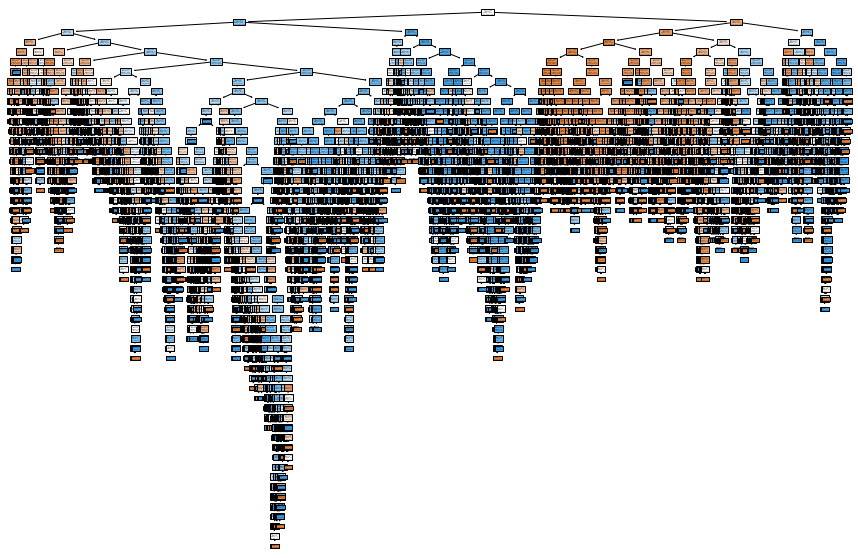

In [104]:
# Visualizing the Decision Tree
plt.figure(figsize=(15,10))
tree.plot_tree(dTree,filled=True)

In [105]:
# Reducing Overfitting
dTreeR = DecisionTreeClassifier(criterion = 'gini', max_depth = 4, random_state=1)
dTreeR.fit(x_trainsc, y_os_train)
print(dTreeR.score(x_trainsc, y_os_train))
print(dTreeR.score(x_testsc, y_test))

DecisionTreeClassifier(max_depth=4, random_state=1)

0.805286241920591
0.7574733824733825


0.7574733824733825


<IPython.core.display.Javascript object>

<Figure size 504x360 with 0 Axes>

<AxesSubplot:>

Accuracy Score for Decision Tree:  0.7574733824733825


ROC score:  0.7889365552608156


Decision Tree Classifier Report


              precision    recall  f1-score   support

         0.0       0.94      0.73      0.82      7391
         1.0       0.50      0.85      0.63      2377

    accuracy                           0.76      9768
   macro avg       0.72      0.79      0.72      9768
weighted avg       0.83      0.76      0.77      9768



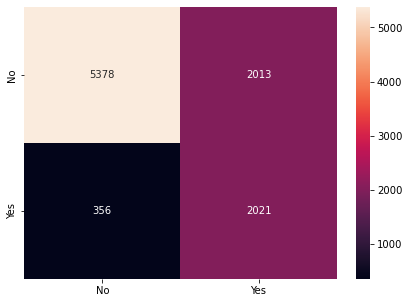

In [106]:
# Decision Tree Analysis Model
print(dTreeR.score(x_testsc , y_test))
y_predict = dTreeR.predict(x_testsc)

cm = confusion_matrix(y_test, y_predict, labels=[0, 1])

df_cm = pd.DataFrame(cm, index = [i for i in ["No","Yes"]],
                  columns = [i for i in ["No","Yes"]])
plt.figure(figsize = (7,5))
sns.heatmap(df_cm, annot=True ,fmt='g')

## Saving the Classification Reports for Meta Learning Models:

pred_report_tree = classification_report(y_test, y_predict , digits=2)

### Saving the ROC_AUC Scores for Meta Learning Algorithms

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_predict)
roc_tree = auc(false_positive_rate, true_positive_rate)

## Saving the accuracy

accuracy = accuracy_score(y_test, y_predict)

print("Accuracy Score for Decision Tree: ",accuracy)
print("\n")
print("ROC score: ",roc_tree)
print("\n")
print("Decision Tree Classifier Report")
print("\n")
print(pred_report_tree)


In [107]:
##### K Fold Cross Validation ####
    
cross_valid = True
cv_score = cross_val_score(dTree , x , y, scoring = 'accuracy', 
                                          cv = KFold(n_splits = 10))
accuracy = accuracy_score(y_test, y_predict)

print("The Cross Validation Score For Baseline Decision Tree Classifier Model After", "Fold Cross Validation Is :  \n", cv_score)
print(" ")
print("The Accuracy Score For Baseline Decision Tree Classifier Model After Cross Validation Is: \n", accuracy)

The Cross Validation Score For Baseline Decision Tree Classifier Model After Fold Cross Validation Is :  
 [0.76504914 0.77856265 0.77825553 0.77242015 0.76259214 0.78040541
 0.7791769  0.78900491 0.77979115 0.76136364]
 
The Accuracy Score For Baseline Decision Tree Classifier Model After Cross Validation Is: 
 0.7574733824733825


In [108]:
### Hyper-parameter Tuning of Decision Tree by Grid Search CV 
criterion = ['gini','entropy','log_class']
max_depth = [1,3,5,7]
max_features = ['sqrt','log2',None]
random_state=[1,5,7,10]

param_grid = dict(criterion=criterion,
                  max_depth=max_depth,
                  max_features=max_features,
                  random_state=random_state)

grid = GridSearchCV(estimator = dTree,
                    param_grid = param_grid,
                    scoring ='accuracy',
                    verbose = 1,
                    n_jobs =-1, 
                    cv = 3)
grid_result = grid.fit(x_trainsc, y_os_train)

print('Best Score: ', grid_result.best_score_)

print('Best Params: ', grid_result.best_params_)

Fitting 3 folds for each of 144 candidates, totalling 432 fits
Best Score:  0.8184441366574332
Best Params:  {'criterion': 'gini', 'max_depth': 7, 'max_features': None, 'random_state': 5}


DecisionTreeClassifier(criterion='entropy', max_depth=7, random_state=7)

0.805286241920591
0.7574733824733825
0.7574733824733825


<IPython.core.display.Javascript object>

<Figure size 504x360 with 0 Axes>

<AxesSubplot:>

Accuracy Score for Decision Tree:  0.7741605241605242


ROC score:  0.7978229898703963


Decision Tree Classifier Report


              precision    recall  f1-score   support

         0.0       0.94      0.75      0.83      7391
         1.0       0.52      0.84      0.65      2377

    accuracy                           0.77      9768
   macro avg       0.73      0.80      0.74      9768
weighted avg       0.84      0.77      0.79      9768



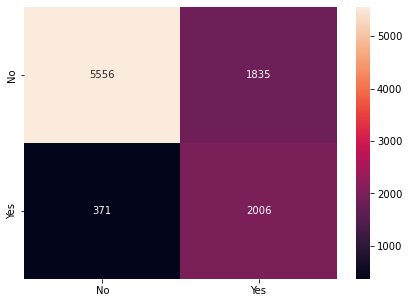

In [109]:
dTreeR2 = DecisionTreeClassifier(criterion = 'gini', max_depth = 7, max_features=None, random_state=5)
dTreeR2.fit(x_trainsc, y_os_train)
print(dTreeR.score(x_trainsc, y_os_train))
print(dTreeR.score(x_testsc, y_test))

# Decision Tree Analysis Model
print(dTreeR.score(x_testsc , y_test))
y_predict = dTreeR2.predict(x_testsc)
cm = confusion_matrix(y_test, y_predict, labels=[0, 1])

df_cm = pd.DataFrame(cm, index = [i for i in ["No","Yes"]],
                  columns = [i for i in ["No","Yes"]])
plt.figure(figsize = (7,5))
sns.heatmap(df_cm, annot=True ,fmt='g')

## Saving the Classification Reports for Meta Learning Models:

pred_report_tree = classification_report(y_test, y_predict , digits=2)

### Saving the ROC_AUC Scores for Meta Learning Algorithms

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_predict)
roc_tree = auc(false_positive_rate, true_positive_rate)

## Saving the accuracy

accuracy = accuracy_score(y_test, y_predict)

print("Accuracy Score for Decision Tree: ",accuracy)
print("\n")
print("ROC score: ",roc_tree)
print("\n")
print("Decision Tree Classifier Report")
print("\n")
print(pred_report_tree)

### Random Forest Classifier Model

In [110]:
rf_model = RandomForestClassifier()
rf_model.fit(x_trainsc, y_os_train)
y_predict= rf_model.predict(x_testsc)

## Saving the Classification Reports for Meta Learning Models:

pred_report_rf = classification_report(y_test, y_predict , digits=2)

### Saving the ROC_AUC Scores for Meta Learning Algorithms

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_predict)
roc_rf = auc(false_positive_rate, true_positive_rate)

## Saving the accuracy

accuracy = accuracy_score(y_test, y_predict)

print("Accuracy Score for Random Forest: ",accuracy)
print("\n")
print("ROC score: ",roc_rf)
print("\n")
print("Random Forest Classifier Report")
print("\n")
print(pred_report_rf)

RandomForestClassifier()

Accuracy Score for Random Forest:  0.813984438984439


ROC score:  0.7603521764950003


Random Forest Classifier Report


              precision    recall  f1-score   support

         0.0       0.89      0.86      0.88      7391
         1.0       0.61      0.66      0.63      2377

    accuracy                           0.81      9768
   macro avg       0.75      0.76      0.75      9768
weighted avg       0.82      0.81      0.82      9768



In [111]:
##### K Fold Cross Validation ####
    
cross_valid = True
cv_score = cross_val_score(rf_model , x , y, scoring = 'accuracy', cv = KFold(n_splits = 10))
accuracy = accuracy_score(y_test, y_predict)

print("The Cross Validation Score For Baseline Random Forest Classifier Model After", "Fold Cross Validation Is :  \n", cv_score)
print(" ")
print("The Accuracy Score For Baseline Random Forest Model After Cross Validation Is: \n", accuracy)

The Cross Validation Score For Baseline Random Forest Classifier Model After Fold Cross Validation Is :  
 [0.81633907 0.81572482 0.82463145 0.81787469 0.81173219 0.83015971
 0.82585995 0.83108108 0.83015971 0.80835381]
 
The Accuracy Score For Baseline Random Forest Model After Cross Validation Is: 
 0.813984438984439


In [112]:
### Hyper-parameter Tuning of Random Forest Classifier

n_estimators = [1,10,100] 
criterion = ['gini','entropy','log_class']
max_features = ['sqrt','log2',None]
bootstrap=[True,False]
random_state=[1,5,7,10]
class_weight=['balanced','balanced_subsample', None]

param_grid = dict(n_estimators=n_estimators,
                  criterion=criterion,
                  max_features=max_features,
                  bootstrap=bootstrap,
                  random_state=random_state,
                  class_weight=class_weight)

grid = GridSearchCV(estimator = rf_model,
                    param_grid = param_grid,
                    scoring ='accuracy',
                    verbose = 1,
                    n_jobs =-1, 
                    cv = 3)
grid_result = grid.fit(x_trainsc, y_os_train)

print('Best Score: ', grid_result.best_score_)

print('Best Params: ', grid_result.best_params_)

Fitting 3 folds for each of 648 candidates, totalling 1944 fits
Best Score:  0.8754328254847645
Best Params:  {'bootstrap': True, 'class_weight': 'balanced', 'criterion': 'entropy', 'max_features': 'sqrt', 'n_estimators': 100, 'random_state': 1}


In [125]:
rf_model2 = RandomForestClassifier(bootstrap=True, class_weight='balanced',criterion='entropy',
                                   max_features='sqrt', n_estimators=100, random_state=1)
rf_model2.fit(x_trainsc, y_os_train)
y_predict= rf_model2.predict(x_testsc)

## Saving the Classification Reports for Meta Learning Models:

pred_report_rf = classification_report(y_test, y_predict , digits=2)

### Saving the ROC_AUC Scores for Meta Learning Algorithms

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_predict)
roc_rf = auc(false_positive_rate, true_positive_rate)

## Saving the accuracy

accuracy = accuracy_score(y_test, y_predict)

print("Accuracy Score for Random Forest: ",accuracy)
print("\n")
print("ROC score: ",roc_rf)
print("\n")
print("Random Forest Classifier Report")
print("\n")
print(pred_report_rf)

RandomForestClassifier(class_weight='balanced', criterion='entropy',
                       random_state=1)

Accuracy Score for Random Forest:  0.8144963144963145


ROC score:  0.7601196283760958


Random Forest Classifier Report


              precision    recall  f1-score   support

         0.0       0.89      0.87      0.88      7391
         1.0       0.61      0.65      0.63      2377

    accuracy                           0.81      9768
   macro avg       0.75      0.76      0.75      9768
weighted avg       0.82      0.81      0.82      9768



### AdaBoosting Algorithm

In [114]:
clf = AdaBoostClassifier()
clf.fit(x_trainsc, y_os_train)
y_pred = clf.predict(x_testsc)

### Saving the ROC_AUC Score

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_pred)
roc_auc_1 = auc(false_positive_rate, true_positive_rate)

########## Printing the Accuracy Score

print("Accuracy Score: ",accuracy_score(y_test, y_pred))
print("\n")
print("roc_auc_1 score: ", roc_auc_1)
########## Printing the Classification Report

print(classification_report(y_test, y_pred, digits=2))


AdaBoostClassifier()

Accuracy Score:  0.7964782964782965


roc_auc_1 score:  0.7977299250865488
              precision    recall  f1-score   support

         0.0       0.93      0.80      0.86      7391
         1.0       0.56      0.80      0.66      2377

    accuracy                           0.80      9768
   macro avg       0.74      0.80      0.76      9768
weighted avg       0.84      0.80      0.81      9768



In [115]:
##### K Fold Cross Validation ####
    
cross_valid = True
cv_score = cross_val_score(clf , x , y, scoring = 'accuracy', cv = KFold(n_splits = 10))
accuracy = accuracy_score(y_test, y_predict)

print("The Cross Validation Score For Baseline Ada Boosting Classifier Model After", "Fold Cross Validation Is :  \n", cv_score)
print(" ")
print("The Accuracy Score For Baseline Ada Boosting Classifier Model After Cross Validation Is: \n", accuracy)

The Cross Validation Score For Baseline Ada Boosting Classifier Model After Fold Cross Validation Is :  
 [0.83077396 0.83538084 0.83937346 0.82739558 0.83660934 0.83783784
 0.83906634 0.84797297 0.83875921 0.83261671]
 
The Accuracy Score For Baseline Ada Boosting Classifier Model After Cross Validation Is: 
 0.8149058149058149


In [116]:
### Hyper-parameter Tuning of Random Forest Classifier

n_estimators = [1,10,100] 
learning_rate= [1,5,7,10]
algorithm= ['SAMME', 'SAMME.R']
random_state=[1,3,5,7,10,11,15,20]

param_grid = dict(n_estimators=n_estimators,
                  learning_rate=learning_rate,
                  random_state=random_state,
                  algorithm=algorithm)

grid = GridSearchCV(estimator = clf,
                    param_grid = param_grid,
                    scoring ='accuracy',
                    verbose = 1,
                    n_jobs =-1, 
                    cv = 3)
grid_result = grid.fit(x_trainsc, y_os_train)

print('Best Score: ', grid_result.best_score_)

print('Best Params: ', grid_result.best_params_)

Fitting 3 folds for each of 192 candidates, totalling 576 fits
Best Score:  0.8305632502308402
Best Params:  {'algorithm': 'SAMME.R', 'learning_rate': 1, 'n_estimators': 100, 'random_state': 1}


In [117]:
clf2 = AdaBoostClassifier(n_estimators =100 ,learning_rate= 1,algorithm='SAMME' , random_state= 1)
clf2.fit(x_trainsc, y_os_train)
y_pred = clf2.predict(x_testsc)

### Saving the ROC_AUC Score

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_pred)
roc_auc_1 = auc(false_positive_rate, true_positive_rate)

########## Printing the Accuracy Score

print("Accuracy Score: ",accuracy_score(y_test, y_pred))
print("\n")
print("roc_auc_1 score: ", roc_auc_1)
########## Printing the Classification Report

print(classification_report(y_test, y_pred, digits=2))




AdaBoostClassifier(algorithm='SAMME', learning_rate=1, n_estimators=100,
                   random_state=1)

Accuracy Score:  0.7938165438165438


roc_auc_1 score:  0.8022497998822545
              precision    recall  f1-score   support

         0.0       0.93      0.79      0.85      7391
         1.0       0.55      0.82      0.66      2377

    accuracy                           0.79      9768
   macro avg       0.74      0.80      0.76      9768
weighted avg       0.84      0.79      0.81      9768



### Gradient Boosting Algorithm

In [118]:
clf3 = GradientBoostingClassifier()
clf3.fit(x_trainsc, y_os_train)
y_pred = clf3.predict(x_testsc)

### Saving the ROC_AUC Score

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_pred)
roc_auc_2 = auc(false_positive_rate, true_positive_rate)

########## Printing the Accuracy Score

print("Accuracy Score: ",accuracy_score(y_test, y_pred))
########## Printing the ROC_AOC Score

print("roc_auc_2 score: ", roc_auc_2)

########## Printing the Classification Report

print(classification_report(y_test, y_pred, digits=2))

<IPython.core.display.Javascript object>

GradientBoostingClassifier()

Accuracy Score:  0.8018018018018018
roc_auc_2 score:  0.8021039130070244
              precision    recall  f1-score   support

         0.0       0.93      0.80      0.86      7391
         1.0       0.57      0.80      0.66      2377

    accuracy                           0.80      9768
   macro avg       0.75      0.80      0.76      9768
weighted avg       0.84      0.80      0.81      9768



In [119]:
##### K Fold Cross Validation ####
    
cross_valid = True
cv_score = cross_val_score(clf3 , x , y, scoring = 'accuracy', cv = KFold(n_splits = 10))
accuracy = accuracy_score(y_test, y_predict)

print("The Cross Validation Score For Baseline Gradient Boosting Classifier Model After", "Fold Cross Validation Is :  \n", cv_score)
print(" ")
print("The Accuracy Score For Baseline Gradient Boosting Classifier Model After Cross Validation Is: \n", accuracy)

The Cross Validation Score For Baseline Gradient Boosting Classifier Model After Fold Cross Validation Is :  
 [0.83077396 0.84090909 0.83998771 0.83384521 0.83814496 0.83968059
 0.84520885 0.8507371  0.84029484 0.83046683]
 
The Accuracy Score For Baseline Gradient Boosting Classifier Model After Cross Validation Is: 
 0.8149058149058149


In [122]:
### Hyper-parameter Tuning of Gradient Boosting Classifier

learning_rate= [1,5,7,10]
n_estimators=[1,10,50,100]
criterion= ['friedman_mse', 'squared_error','mse']
random_state=[1,3,5,7]


param_grid = dict(n_estimators=n_estimators,
                  learning_rate=learning_rate,
                  criterion=criterion,
                  random_state=random_state)

grid = GridSearchCV(estimator = clf3,
                    param_grid = param_grid,
                    scoring ='roc_auc',
                    verbose = 1,
                    n_jobs =-1, 
                    cv = 3)
grid_result = grid.fit(x_trainsc, y_os_train)

print('Best Score: ', grid_result.best_score_)

print('Best Params: ', grid_result.best_params_)

Fitting 3 folds for each of 192 candidates, totalling 576 fits
Best Score:  0.9475939608975147
Best Params:  {'criterion': 'squared_error', 'learning_rate': 1, 'n_estimators': 100, 'random_state': 7}


In [123]:
clf4 = GradientBoostingClassifier(loss ='exponential' ,learning_rate=1 ,n_estimators=100 ,criterion='friedman_mse' , random_state=15 )
clf4.fit(x_trainsc, y_os_train)
y_pred = clf4.predict(x_testsc)

### Saving the ROC_AUC Score

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_pred)
roc_auc_2 = auc(false_positive_rate, true_positive_rate)

########## Printing the Accuracy Score

print("Accuracy Score: ",accuracy_score(y_test, y_pred))
########## Printing the ROC_AOC Score

print("roc_auc_2 score: ", roc_auc_2)

########## Printing the Classification Report

print(classification_report(y_test, y_pred, digits=2))




<IPython.core.display.Javascript object>

GradientBoostingClassifier(learning_rate=1, loss='exponential', random_state=15)

Accuracy Score:  0.822993447993448
roc_auc_2 score:  0.7634513760980152
              precision    recall  f1-score   support

         0.0       0.89      0.88      0.88      7391
         1.0       0.63      0.65      0.64      2377

    accuracy                           0.82      9768
   macro avg       0.76      0.76      0.76      9768
weighted avg       0.82      0.82      0.82      9768



In [126]:
## Saving the best fit model
saved_model = pickle.dumps(svm_model)

## Conclusion:
For this model, recall is more important than precision. It is vital for any user of this data to work on the income of the targeted class of people. Hence, their aim would be to cater to people depending on their income. Any wrong identification of the income class can backfire the user. Therefore, we have chosen the model with the maximum recall, area under the curve and accuracy.